# Steam game Recommender System - Content-Based

## Machine Learning Steps:

1. Data Collection and Preprocessing:

- 1.1 Import dataset
- 1.2 Merge dataframes based on 'steam_appid'
- 1.3 Normalize text data

2. Feature Extraction:

- 2.1 TF-IDF Vectorization
- 2.2 Count Vectorization

3. Exploratory Data Analysis (EDA):
- 3.1 Conduct descriptive analysis
- 3.2 Identify data patterns and trends

4. Modeling:
- 4.1 Similarity Calculation:
    - 4.1.1 Linear Kernel for similarity measurement
    - 4.1.2 Cosine Similarity for similarity measurement
- 4.2 Benchmark
- 4.3 Pipeline

5. Recommendation Algorithm:
- Develop a content-based recommendation system based on analyzed data

6. Deployment (Gradio)

## Dataset (Kaggle)
- Combined data of 27,000 games scraped from Steam and SteamSpy APIs    
- Source: https://www.kaggle.com/datasets/nikdavis/steam-store-games/data

## Overview & Objective:

**Overview**:
In this project, we will be working with a dataset containing information about different Steam games, including their attributes such as release date, developer, genres, and user ratings. By utilizing natural language processing (NLP) techniques, 

**Objective**:
to suggest games based on their similarities with the user's preferences.

- **Business Type**: Gaming and Entertainment

- **Business Objective**: 
    - Enhance user engagement and satisfaction within the gaming community. By providing personalized game recommendations, 
    - Aim is to increase user retention, drive game exploration, and ultimately contribute to increased game sales and customer loyalty.

- **Learning Problems**: Item similarity

- **Reason for Choosing this Project**: Recommendation systems that can help users navigate through the extensive game options. 

- **Expected Result**: similarity(game attributes + users' interests/user's preferences) = match score

- **Utilization of Results**: recommendation system will be integrated into the Steam platform to provide users with personalized game suggestions directly on their dashboard.

- **Benefits of this Project**:
    - Improved user experience through personalized game recommendations
    - Increased user engagement and retention within the Steam platform
    - Enhanced game exploration, leading to increased game sales and user satisfaction
    - Efficient utilization of the vast library of Steam games, ensuring that users find relevant and enjoyable content tailored to their preferences
    - Insights into user preferences and trends that can inform future game development and marketing strategies within the gaming industry.

# Let's dive in

# **1. Data Collection and Preprocessing:**
- Preprocess the data by handling missing values, converting categorical features into numerical representations, and normalizing numerical features.

- Perform data cleaning and preprocessing on the collected data. This may involve tasks such as text normalization, tokenization, and removing stopwords.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re

In [2]:
cmap = sns.color_palette("ch:start=.2,rot=-.3", as_cmap=True)

## 1.1 Import dataset

In [3]:
steam = pd.read_csv(
    r"D:\Repo\DS\RecommenderSystem\Content-Based-SteamGame\repository\steam.csv")
steam_description = pd.read_csv(
    r"D:\Repo\DS\RecommenderSystem\Content-Based-SteamGame\repository\steam_description_data.csv")
steam_media_data = pd.read_csv(
    r"D:\Repo\DS\RecommenderSystem\Content-Based-SteamGame\repository\steam_media_data.csv")


In [4]:
steam.head()

,appid,name,release_date,english,developer,publisher,platforms,required_age,categories,genres,steamspy_tags,achievements,positive_ratings,negative_ratings,average_playtime,median_playtime,owners,price
0,10,Counter-Strike,2000-11-01,1,Valve,Valve,windows;mac;linux,0,Multi-player;Online Multi-Player;Local Multi-P...,Action,Action;FPS;Multiplayer,0,124534,3339,17612,317,10000000-20000000,7.19
1,20,Team Fortress Classic,1999-04-01,1,Valve,Valve,windows;mac;linux,0,Multi-player;Online Multi-Player;Local Multi-P...,Action,Action;FPS;Multiplayer,0,3318,633,277,62,5000000-10000000,3.99
2,30,Day of Defeat,2003-05-01,1,Valve,Valve,windows;mac;linux,0,Multi-player;Valve Anti-Cheat enabled,Action,FPS;World War II;Multiplayer,0,3416,398,187,34,5000000-10000000,3.99
3,40,Deathmatch Classic,2001-06-01,1,Valve,Valve,windows;mac;linux,0,Multi-player;Online Multi-Player;Local Multi-P...,Action,Action;FPS;Multiplayer,0,1273,267,258,184,5000000-10000000,3.99
4,50,Half-Life: Opposing Force,1999-11-01,1,Gearbox Software,Valve,windows;mac;linux,0,Single-player;Multi-player;Valve Anti-Cheat en...,Action,FPS;Action;Sci-fi,0,5250,288,624,415,5000000-10000000,3.99


In [5]:
steam_description.head()


,steam_appid,detailed_description,about_the_game,short_description
0,10,Play the world's number 1 online action game. ...,Play the world's number 1 online action game. ...,Play the world's number 1 online action game. ...
1,20,One of the most popular online action games of...,One of the most popular online action games of...,One of the most popular online action games of...
2,30,Enlist in an intense brand of Axis vs. Allied ...,Enlist in an intense brand of Axis vs. Allied ...,Enlist in an intense brand of Axis vs. Allied ...
3,40,Enjoy fast-paced multiplayer gaming with Death...,Enjoy fast-paced multiplayer gaming with Death...,Enjoy fast-paced multiplayer gaming with Death...
4,50,Return to the Black Mesa Research Facility as ...,Return to the Black Mesa Research Facility as ...,Return to the Black Mesa Research Facility as ...


In [6]:
steam_media_data.head()


,steam_appid,header_image,screenshots,background,movies
0,10,https://steamcdn-a.akamaihd.net/steam/apps/10/...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/10/...,NaN
1,20,https://steamcdn-a.akamaihd.net/steam/apps/20/...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/20/...,NaN
2,30,https://steamcdn-a.akamaihd.net/steam/apps/30/...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/30/...,NaN
3,40,https://steamcdn-a.akamaihd.net/steam/apps/40/...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/40/...,NaN
4,50,https://steamcdn-a.akamaihd.net/steam/apps/50/...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/50/...,NaN


In [7]:
steam.isna().sum()


appid                0
name                 0
release_date         0
english              0
developer            1
publisher           14
platforms            0
required_age         0
categories           0
genres               0
steamspy_tags        0
achievements         0
positive_ratings     0
negative_ratings     0
average_playtime     0
median_playtime      0
owners               0
price                0
dtype: int64

## 1.2 Data Merging
merge 3 dataframe by 'steam_appid'

In [8]:
steam = steam.rename(columns={'appid': 'steam_appid'})

In [9]:
merged_df = steam.merge(steam_description, on='steam_appid', how='left').merge(
    steam_media_data, on='steam_appid', how='left')

In [10]:
merged_df

,steam_appid,name,release_date,english,developer,publisher,platforms,required_age,categories,genres,...,median_playtime,owners,price,detailed_description,about_the_game,short_description,header_image,screenshots,background,movies
0,10,Counter-Strike,2000-11-01,1,Valve,Valve,windows;mac;linux,0,Multi-player;Online Multi-Player;Local Multi-P...,Action,...,317,10000000-20000000,7.19,Play the world's number 1 online action game. ...,Play the world's number 1 online action game. ...,Play the world's number 1 online action game. ...,https://steamcdn-a.akamaihd.net/steam/apps/10/...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/10/...,NaN
1,20,Team Fortress Classic,1999-04-01,1,Valve,Valve,windows;mac;linux,0,Multi-player;Online Multi-Player;Local Multi-P...,Action,...,62,5000000-10000000,3.99,One of the most popular online action games of...,One of the most popular online action games of...,One of the most popular online action games of...,https://steamcdn-a.akamaihd.net/steam/apps/20/...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/20/...,NaN
2,30,Day of Defeat,2003-05-01,1,Valve,Valve,windows;mac;linux,0,Multi-player;Valve Anti-Cheat enabled,Action,...,34,5000000-10000000,3.99,Enlist in an intense brand of Axis vs. Allied ...,Enlist in an intense brand of Axis vs. Allied ...,Enlist in an intense brand of Axis vs. Allied ...,https://steamcdn-a.akamaihd.net/steam/apps/30/...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/30/...,NaN
3,40,Deathmatch Classic,2001-06-01,1,Valve,Valve,windows;mac;linux,0,Multi-player;Online Multi-Player;Local Multi-P...,Action,...,184,5000000-10000000,3.99,Enjoy fast-paced multiplayer gaming with Death...,Enjoy fast-paced multiplayer gaming with Death...,Enjoy fast-paced multiplayer gaming with Death...,https://steamcdn-a.akamaihd.net/steam/apps/40/...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/40/...,NaN
4,50,Half-Life: Opposing Force,1999-11-01,1,Gearbox Software,Valve,windows;mac;linux,0,Single-player;Multi-player;Valve Anti-Cheat en...,Action,...,415,5000000-10000000,3.99,Return to the Black Mesa Research Facility as ...,Return to the Black Mesa Research Facility as ...,Return to the Black Mesa Research Facility as ...,https://steamcdn-a.akamaihd.net/steam/apps/50/...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/50/...,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27070,1065230,Room of Pandora,2019-04-24,1,SHEN JIAWEI,SHEN JIAWEI,windows,0,Single-player;Steam Achievements,Adventure;Casual;Indie,...,0,0-20000,2.09,"<img src=""https://steamcdn-a.akamaihd.net/stea...","<img src=""https://steamcdn-a.akamaihd.net/stea...",The Room of Pandora is a third-person interact...,https://steamcdn-a.akamaihd.net/steam/apps/106...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/106...,"[{'id': 256747452, 'name': 'Video', 'thumbnail..."
27071,1065570,Cyber Gun,2019-04-23,1,Semyon Maximov,BekkerDev Studio,windows,0,Single-player,Action;Adventure;Indie,...,0,0-20000,1.69,Have you ever been so lonely that no one but y...,Have you ever been so lonely that no one but y...,Cyber Gun is a hardcore first-person shooter w...,https://steamcdn-a.akamaihd.net/steam/apps/106...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/106...,"[{'id': 256747487, 'name': 'Game Trailer', 'th..."
27072,1065650,Super Star Blast,2019-04-24,1,EntwicklerX,EntwicklerX,windows,0,Single-player;Multi-player;Co-op;Shared/Split ...,Action;Casual;Indie,...,0,0-20000,3.99,<strong>Super Star Blast </strong>is a space b...,<strong>Super Star Blast </strong>is a space b...,Super Star Blast is a space based game with ch...,https://steamcdn-a.akamaihd.net/steam/apps/106...,"[{'i

In [11]:
merged_df.isna().sum()

steam_appid                0
name                       0
release_date               0
english                    0
developer                  1
publisher                 14
platforms                  0
required_age               0
categories                 0
genres                     0
steamspy_tags              0
achievements               0
positive_ratings           0
negative_ratings           0
average_playtime           0
median_playtime            0
owners                     0
price                      0
detailed_description       0
about_the_game             0
short_description          0
header_image               0
screenshots                0
background                 0
movies                  1682
dtype: int64

In [12]:
merged_df.loc[merged_df['developer'].isna()]


,steam_appid,name,release_date,english,developer,publisher,platforms,required_age,categories,genres,...,median_playtime,owners,price,detailed_description,about_the_game,short_description,header_image,screenshots,background,movies
23071,881910,The Battle Of Ages,2018-09-07,1,NaN,NaN,windows,0,Multi-player;Online Multi-Player,Action;Indie;Massively Multiplayer;RPG;Early A...,...,0,0-20000,3.99,The Battle of Ages is an online shooter where ...,The Battle of Ages is an online shooter where ...,The Battle Of Ages is a fun entertaining actio...,https://steamcdn-a.akamaihd.net/steam/apps/881...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/881...,"[{'id': 256727457, 'name': 'Gameplay', 'thumbn..."


In [13]:
merged_df.loc[merged_df['publisher'].isna()]


,steam_appid,name,release_date,english,developer,publisher,platforms,required_age,categories,genres,...,median_playtime,owners,price,detailed_description,about_the_game,short_description,header_image,screenshots,background,movies
3420,307170,Borealis,2014-09-02,1,Conrad Nelson,NaN,windows,0,Single-player;Steam Achievements;Steam Trading...,Action;Casual;Indie,...,146,50000-100000,3.99,Borealis is a Zen game focused on measured mot...,Borealis is a Zen game focused on measured mot...,"Weave through missiles to generated music, and...",https://steamcdn-a.akamaihd.net/steam/apps/307...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/307...,"[{'id': 2034256, 'name': 'Trailer', 'thumbnail..."
4511,341120,Glorkian Warrior: The Trials Of Glork,2015-03-24,1,Pixeljam,NaN,windows;mac,0,Single-player;Steam Achievements;Full controll...,Indie,...,274,20000-50000,2.79,BECOME A GLORKIAN WARRIOR! Visit awesome aster...,BECOME A GLORKIAN WARRIOR! Visit awesome aster...,A comic-styled mashup of Galaga-style shoot-em...,https://steamcdn-a.akamaihd.net/steam/apps/341...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/341...,"[{'id': 2037474, 'name': 'Launch Trailer', 'th..."
5229,359370,Pirate's Life,2015-04-17,1,Team Eyepatch,NaN,windows,0,Single-player,Simulation;Strategy,...,0,0-20000,3.99,Pirate's Life is a 2D strategy game / city bui...,Pirate's Life is a 2D strategy game / city bui...,Pirate's Life is a 2D strategy game / city bui...,https://steamcdn-a.akamaihd.net/steam/apps/359...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/359...,"[{'id': 2038231, 'name': 'Release Trailer', 't..."
7464,422940,Divergence: Online,2016-01-06,1,Stained Glass Llama,NaN,windows,0,Multi-player;MMO;Steam Turn Notifications,Action;Indie;Massively Multiplayer;RPG;Early A...,...,0,0-20000,14.99,"It's the year 2330, Earth Standard Date.<br><b...","It's the year 2330, Earth Standard Date.<br><b...",Divergence: Online is an open-world sandbox MM...,https://steamcdn-a.akamaihd.net/steam/apps/422...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/422...,"[{'id': 256659479, 'name': 'Steam Vid MP4', 't..."
7911,436240,Melancholy Republic,2018-04-12,1,Cloud Runner Studios,NaN,windows,0,Single-player,Adventure;Casual;Indie,...,0,0-20000,6.99,<u>Releasing on Wednesday April 11th 2018!</u>...,<u>Releasing on Wednesday April 11th 2018!</u>...,"A story driven experience about an ambitious, ...",https://steamcdn-a.akamaihd.net/steam/apps/436...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/436...,"[{'id': 256713907, 'name': 'New Trailer', 'thu..."
9894,498710,After Dreams,2018-05-06,1,Matt Boyer,NaN,windows,0,Single-player,Violent;Adventure;Casual;Free to Play;Indie;Si...,...,1,20000-50000,0.00,"<h2 class=""bb_tag"">What is this?</h2><strong>A...","<h2 class=""bb_tag"">What is this?</h2><strong>A...",After Dreams is a story-rich exploration game ...,https://steamcdn-a.akamaihd.net/steam/apps/498...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/498...,"[{'id': 256715776, 'name': 'Main', 'thumbnail'..."
10011,502150,Interstellar Logistics Inc,2016-08-15,1,Exalted Guy Interactive,NaN,windows,0,Single-player,Casual,...,281,0-20000,2.09,Interstellar Logistics Inc. is a gravity based...,Interstellar Logistics Inc. is a gravity based...,Interstellar Logistics Inc. is an action puzzl...,https://steamcdn-a.akamaihd.net/steam/apps/502...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/502...,"[{'id': 256666888, 'name': 'Main Trailer', 'th..."
10564,516430,Ruin of the Reckless,2017-04-26,1,Faux-Operative Games,NaN,windows,0,Single-player;Co-op;Local Co-op;Shared/Split S...,Action;Adventure;Indie;RPG,...,0,0-20000,6.99,"&quot;What's that music in the trailer&

In [14]:
merged_df.shape

(27075, 25)

In [15]:
merged_df.drop_duplicates(subset='steam_appid', inplace=True)
merged_df.shape


(27075, 25)

In [16]:
merged_df.isna().sum()

steam_appid                0
name                       0
release_date               0
english                    0
developer                  1
publisher                 14
platforms                  0
required_age               0
categories                 0
genres                     0
steamspy_tags              0
achievements               0
positive_ratings           0
negative_ratings           0
average_playtime           0
median_playtime            0
owners                     0
price                      0
detailed_description       0
about_the_game             0
short_description          0
header_image               0
screenshots                0
background                 0
movies                  1682
dtype: int64

In [17]:
merged_df.dropna(subset=['developer', 'publisher'], inplace=True)
merged_df.isna().sum()

steam_appid                0
name                       0
release_date               0
english                    0
developer                  0
publisher                  0
platforms                  0
required_age               0
categories                 0
genres                     0
steamspy_tags              0
achievements               0
positive_ratings           0
negative_ratings           0
average_playtime           0
median_playtime            0
owners                     0
price                      0
detailed_description       0
about_the_game             0
short_description          0
header_image               0
screenshots                0
background                 0
movies                  1682
dtype: int64

In [18]:
merged_df.shape

(27061, 25)

In [19]:
merged_df["name"].value_counts()

name
Dark Matter               3
City Builder              2
Experience                2
New York Bus Simulator    2
Solitaire                 2
                         ..
Prehistoric Tales         1
Ghost Croquet             1
ARAYA                     1
King's Guard TD           1
Rune Lord                 1
Name: count, Length: 27019, dtype: int64

In [20]:
merged_df.nunique()


steam_appid             27061
name                    27019
release_date             2619
english                     2
developer               17102
publisher               14353
platforms                   7
required_age                6
categories               3331
genres                   1551
steamspy_tags            6420
achievements              410
positive_ratings         2800
negative_ratings         1492
average_playtime         1345
median_playtime          1312
owners                     13
price                     282
detailed_description    27044
about_the_game          27044
short_description       26936
header_image            27061
screenshots             27061
background              27061
movies                  25377
dtype: int64

In [21]:
merged_df['english'].value_counts()


english
1    26550
0      511
Name: count, dtype: int64

In [22]:
merged_df['platforms'].value_counts()


platforms
windows              18387
windows;mac;linux     4622
windows;mac           3438
windows;linux          609
mac                      3
mac;linux                1
linux                    1
Name: count, dtype: int64

In [23]:
merged_df['required_age'].value_counts()

required_age
0     26465
18      308
16      192
12       73
7        12
3        11
Name: count, dtype: int64

In [24]:
numeric_cols = merged_df.select_dtypes(
    include=['int64', 'float64']).columns.to_list()
numeric_cols

['steam_appid',
 'english',
 'required_age',
 'achievements',
 'positive_ratings',
 'negative_ratings',
 'average_playtime',
 'median_playtime',
 'price']

In [25]:
merged_df[numeric_cols].describe().T

,count,mean,std,min,25%,50%,75%,max
steam_appid,27061.0,596219.206127,250917.419966,10.0,401210.00,599090.00,798790.00,1069460.00
english,27061.0,0.981117,0.136115,0.0,1.00,1.00,1.00,1.00
required_age,27061.0,0.355087,2.406653,0.0,0.00,0.00,0.00,18.00
achievements,27061.0,45.270278,352.760212,0.0,0.00,7.00,23.00,9821.00
positive_ratings,27061.0,1001.041573,18993.623903,0.0,6.00,24.00,126.00,2644404.00
negative_ratings,27061.0,211.120579,4286.044728,0.0,2.00,9.00,42.00,487076.00
average_playtime,27061.0,149.847197,1827.507970,0.0,0.00,0.00,0.00,190625.00
median_playtime,27061.0,146.095821,2354.486857,0.0,0.00,0.00,0.00,190625.00
price,27061.0,6.079350,7.876308,0.0,1.69,3.99,7.19,421.99


In [26]:
merged_df['total_ratings'] = merged_df['positive_ratings'] - merged_df['negative_ratings']

In [27]:
merged_df['total_ratings']


0        121195
1          2685
2          3018
3          1006
4          4962
          ...  
27070         3
27071         7
27072        -1
27073         2
27074         4
Name: total_ratings, Length: 27061, dtype: int64

In [28]:
merged_df.describe().T

,count,mean,std,min,25%,50%,75%,max
steam_appid,27061.0,596219.206127,250917.419966,10.0,401210.00,599090.00,798790.00,1069460.00
english,27061.0,0.981117,0.136115,0.0,1.00,1.00,1.00,1.00
required_age,27061.0,0.355087,2.406653,0.0,0.00,0.00,0.00,18.00
achievements,27061.0,45.270278,352.760212,0.0,0.00,7.00,23.00,9821.00
positive_ratings,27061.0,1001.041573,18993.623903,0.0,6.00,24.00,126.00,2644404.00
negative_ratings,27061.0,211.120579,4286.044728,0.0,2.00,9.00,42.00,487076.00
average_playtime,27061.0,149.847197,1827.507970,0.0,0.00,0.00,0.00,190625.00
median_playtime,27061.0,146.095821,2354.486857,0.0,0.00,0.00,0.00,190625.00
price,27061.0,6.079350,7.876308,0.0,1.69,3.99,7.19,421.99
total_ratings,27061.0,789.920993,15966.588766,-7738.0,2.00,12.00,74.00,2242091.00


In [29]:
merged_df = merged_df.drop(
    merged_df[merged_df['total_ratings'] <= 10].index).reset_index(drop=True)

In [30]:
merged_df.shape

(14090, 26)

In [31]:
merged_df = merged_df.drop(
    merged_df[merged_df['english'] == 0].index).reset_index(drop=True)

In [32]:
merged_df.shape


(13832, 26)

In [166]:
merged_df.to_csv('metadata.csv', index=False)

## 1.3 Text Normalization
converting text data into a standardized or normalized form and to clean and make the text consistent.

- **1. Lowercasing**: Converting all text to lowercase to ensure uniformity. For example, "Hello" and "hello" become "hello."
- **2. Removing Punctuation**: Removing punctuation marks such as periods, commas, and quotation marks to focus on the text content.
- **3. Removing Stopwords**: Stopwords are common words (e.g., "the," "and," "in") that are often removed from text because they don't carry significant meaning for many NLP tasks.
- **4. Stemming and Lemmatization**: Reducing words to their root or base form. For example, "running" becomes "run." Stemming is more aggressive and might produce non-real words, while lemmatization ensures that the resulting word is a real one.
- **5. Handling Accents and Diacritics**: Replacing accented characters with their unaccented equivalents. For example, "café" becomes "cafe."
- **6. Handling Contractions**: Expanding contractions, such as changing "I've" to "I have." | "She'd" to She would" | "I'll" to "I will"
- **7. Handling Special Characters**: Replacing or removing special characters or symbols that are not relevant to the analysis.

Text normalization helps in reducing the dimensionality of the text data, making it more consistent, and ensuring that the text is prepared for further processing.

In [33]:
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
import contractions

from unidecode import unidecode

nltk.download('wordnet')
nltk.download('stopwords')

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Windows10\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Windows10\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [34]:
# 1. Lowercasing:
def lowercase(string):
    return str(string).lower()

# 2. Removing Punctuation:
def remove_punctuation(string):
    tokenizer = RegexpTokenizer(r'\w+')
    string = tokenizer.tokenize(string)
    string = " ".join(string)
    return string
# 3. Removing Stopwords:
def remove_stop_words(string):
    string = string.split()
    stops = set(stopwords.words("english"))
    string = [w for w in string if not w in stops]
    string = " ".join(string)
    return string

# 4. Stemming:
def stemming(string):
    stemmer = PorterStemmer()
    words = string.split()
    stemmed_words = [stemmer.stem(word) for word in words]
    return ' '.join(stemmed_words)


# 5. Lemmatization :
def lemmatization(string):
    lemmatizer = WordNetLemmatizer()

    words = string.split(' ')
    lemmatized_words = [lemmatizer.lemmatize(word) for word in words]
    return ' '.join(lemmatized_words)

# 6. Handling Accents and Diacritics Function:
def handle_accents_and_diacritics(string):
    return unidecode(string)

# 7. Handling Contractions Function:
def handle_contractions(string):
    # creating an empty list
    expanded_words = []
    for word in string.split():
        # using contractions.fix to expand the shortened words
        expanded_words.append(contractions.fix(word))

    expanded_text = ' '.join(expanded_words)
    return expanded_text
# 8. Handling Special Characters Function:

def handle_special_characters(string):
    return re.sub(r'[^a-zA-Z0-9\s]', ' ', string)


In [35]:
# Others
def globalization(string: str):
    return str(string).replace(';', ' ')


def remove_html(string):
    html_pattern = re.compile('<.*?>')
    return html_pattern.sub(r'', string)


### Example 1: After apply each **function**

In [36]:
sample_text = "I've a cat and café, I do like petting cats in daily"

In [37]:
# Lower case
lowercase(sample_text)

"i've a cat and café, i do like petting cats in daily"

In [38]:
# remove ' and ,
remove_punctuation(sample_text)

'I ve a cat and café I do like petting cats in daily'

In [39]:
# remove a,do,not, to
remove_stop_words(sample_text)

"I've cat café, I like petting cats daily"

In [40]:
# Change daily  to daili
stemming(sample_text)

"i'v a cat and café, i do like pet cat in daili"

In [41]:
# Change cats to cat
lemmatization(sample_text)


"I've a cat and café, I do like petting cat in daily"

In [42]:
# Change café to cafe
handle_accents_and_diacritics(sample_text)

"I've a cat and cafe, I do like petting cats in daily"

In [43]:
# Change I've to I have
handle_contractions(sample_text)

'I have a cat and café, I do like petting cats in daily'

In [44]:
# remove non-acii
handle_special_characters(sample_text)

'I ve a cat and caf   I do like petting cats in daily'

In [45]:
def text_normalization(string):
    string = handle_contractions(string)
    string = handle_accents_and_diacritics(string)
    string = remove_punctuation(string)
    string = remove_stop_words(string)
    # string = stemming(string)
    string = lemmatization(string)
    string = handle_special_characters(string)
    string = lowercase(string)
    return string

### Example 2: sort **function** and oberve before/after

In [46]:
sampled_indexes = merged_df.sample(10).index

# Process text_normalization function on the sampled text
for index in sampled_indexes:
    print(f"Index: {index}")
    sample_text = merged_df.loc[index, 'short_description']
    print(f"Length of Text: {len(sample_text)} characters")
    print(f"Original Text: {sample_text}")
    print('-'*10)
    normalized_text = text_normalization(sample_text)
    print(f"Length of Text: {len(normalized_text)} characters")
    print(f"Normalized Text: {normalized_text}")
    print('-'*100)

    print("\n")


Index: 235
Length of Text: 328 characters
Original Text: A true reincarnation of the legendary series!The Almighty has turned away from Nevendaar and its denizens. He is busy thinking about the fate of the world. Above Nevendaar, rent by perpetual wars, a new star flashed out. What will it bring with it? Who will claim its great power? Immerse in the struggle of four powerful races!
----------
Length of Text: 229 characters
Normalized Text: a true reincarnation legendary series the almighty turned away nevendaar denizen he busy thinking fate world above nevendaar rent perpetual war new star flashed what bring who claim great power immerse struggle four powerful race
----------------------------------------------------------------------------------------------------


Index: 1260
Length of Text: 151 characters
Original Text: Resident Evil® Revelations returns redefined for PC complete with high quality HD visuals, enhanced lighting effects and an immersive sound experience.
----------
L

### Apply

select game contents:
- name
- developer
- genres
- steamspy_tags 
- short_description (computation & memory constraints)
- header_image (optional, for display image)

for put in model and make model do item similarity job

In [47]:
df_rec = merged_df[['steam_appid', 
                    'name',
                    'developer', 
                    'genres',
                    'steamspy_tags', 
                    # this is informative content, But my local PC can't take this high computation ;_;, So I decided not to put in cosine similarity
                    'short_description', 
                    # For display image of game
                    'header_image']]
df_rec

,steam_appid,name,developer,genres,steamspy_tags,short_description,header_image
0,10,Counter-Strike,Valve,Action,Action;FPS;Multiplayer,Play the world's number 1 online action game. ...,https://steamcdn-a.akamaihd.net/steam/apps/10/...
1,20,Team Fortress Classic,Valve,Action,Action;FPS;Multiplayer,One of the most popular online action games of...,https://steamcdn-a.akamaihd.net/steam/apps/20/...
2,30,Day of Defeat,Valve,Action,FPS;World War II;Multiplayer,Enlist in an intense brand of Axis vs. Allied ...,https://steamcdn-a.akamaihd.net/steam/apps/30/...
3,40,Deathmatch Classic,Valve,Action,Action;FPS;Multiplayer,Enjoy fast-paced multiplayer gaming with Death...,https://steamcdn-a.akamaihd.net/steam/apps/40/...
4,50,Half-Life: Opposing Force,Gearbox Software,Action,FPS;Action;Sci-fi,Return to the Black Mesa Research Facility as ...,https://steamcdn-a.akamaihd.net/steam/apps/50/...
...,...,...,...,...,...,...,...
13827,1058430,A Legionary's Life,Alessandro Roberti,Indie;RPG;Early Access,Early Access;RPG;Indie,A Legionary's Life lets you play as a Roman so...,https://steamcdn-a.akamaihd.net/steam/apps/105...
13828,1059090,The Underground Watcher/地下监察员,Yima VLG.,Action;Indie,Action;Indie;Pixel Graphics,This is a story about a girl working undergrou...,https://steamcdn-a.akamaihd.net/steam/apps/105...
13829,1059280,The Renovator,mirzagame5,Indie,Indie;Horror;Adventure,In this game you’re an experienced restorer cu...,https://steamcdn-a.akamaihd.net/steam/apps/105...
13830,1062670,Blacksmith Run,Skull Box Games,Indie,Indie,Go with the brave blacksmith on his journey fo...,https://steamcdn-a.akamaihd.net/steam/apps/106...


In [48]:
steam_content_cols = ['name', 'developer', 'genres', 'steamspy_tags']

In [49]:
for col in steam_content_cols:
    df_rec[col] = df_rec[col].apply(text_normalization)

C:\Users\Windows10\AppData\Local\Temp\ipykernel_27228\2428197956.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_rec[col] = df_rec[col].apply(text_normalization)
C:\Users\Windows10\AppData\Local\Temp\ipykernel_27228\2428197956.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_rec[col] = df_rec[col].apply(text_normalization)
C:\Users\Windows10\AppData\Local\Temp\ipykernel_27228\2428197956.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .

In [50]:
df_rec[steam_content_cols]

,name,developer,genres,steamspy_tags
0,counter strike,valve,action,action fps multiplayer
1,team fortress classic,valve,action,action fps multiplayer
2,day defeat,valve,action,fps world war ii multiplayer
3,deathmatch classic,valve,action,action fps multiplayer
4,half life opposing force,gearbox software,action,fps action sci fi
...,...,...,...,...
13827,a legionary life,alessandro roberti,indie rpg early access,early access rpg indie
13828,the underground watcher di xia jian cha yuan,yima vlg,action indie,action indie pixel graphics
13829,the renovator,mirzagame5,indie,indie horror adventure
13830,blacksmith run,skull box games,indie,indie


In [51]:
steam_descrip_cols = ['short_description']

In [52]:
for col in steam_descrip_cols:
    df_rec[col] = df_rec[col].apply(text_normalization)

C:\Users\Windows10\AppData\Local\Temp\ipykernel_27228\2117701091.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_rec[col] = df_rec[col].apply(text_normalization)


In [53]:
df_rec[steam_descrip_cols]

,short_description
0,play world number 1 online action game engage ...
1,one popular online action game time team fortr...
2,enlist intense brand axis v allied teamplay se...
3,enjoy fast paced multiplayer gaming deathmatch...
4,return black mesa research facility one milita...
...,...
13827,a legionary life let u play roman soldier year...
13828,this story girl working underground experienci...
13829,in game experienced restorer currently working...
13830,go brave blacksmith journey hammer gods to get...


# 2. **Feature Extraction**

- 2.1 TF-IDF Vectorization
- 2.2 Count Vectorization

Objective: 
- Transform categorical features like 
    - 'genres'
    - 'categories' 
    -  'steamspy_tags' 
    
into binary vectors using techniques like one-hot encoding or TF-IDF (Term Frequency-Inverse Document Frequency).

## Combine **Genre** & **Steam_tags**
**Reason**: These 2 features are a little bit duplicated, So combine it and remove the duplicated

In [54]:
df_rec['genres&tags'] = df_rec['genres'] + ' ' + df_rec['steamspy_tags']

C:\Users\Windows10\AppData\Local\Temp\ipykernel_27228\249278838.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_rec['genres&tags'] = df_rec['genres'] + ' ' + df_rec['steamspy_tags']


In [55]:
df_rec['genres&tags']


0                            action action fps multiplayer
1                            action action fps multiplayer
2                      action fps world war ii multiplayer
3                            action action fps multiplayer
4                                 action fps action sci fi
                               ...                        
13827        indie rpg early access early access rpg indie
13828             action indie action indie pixel graphics
13829                         indie indie horror adventure
13830                                          indie indie
13831    adventure indie early access early access indi...
Name: genres&tags, Length: 13832, dtype: object

In [56]:
def del_duplicate_tag(string: str):
    spl_string = string.split()
    return ' '.join(sorted(set(spl_string), key=spl_string.index))

In [57]:
df_rec['genres&tags'] = df_rec['genres&tags'].apply(del_duplicate_tag)

C:\Users\Windows10\AppData\Local\Temp\ipykernel_27228\1487734202.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_rec['genres&tags'] = df_rec['genres&tags'].apply(del_duplicate_tag)


## Combine all content
combine related content
- name
- developer
- geres&tag

to put in Vectorizer

In [58]:
df_rec['all'] = df_rec['name'] + ' ' + \
    df_rec['developer'] + ' ' + df_rec['genres&tags']

C:\Users\Windows10\AppData\Local\Temp\ipykernel_27228\3317113153.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_rec['all'] = df_rec['name'] + ' ' + \


In [59]:
df_rec['all']

0              counter strike valve action fps multiplayer
1        team fortress classic valve action fps multipl...
2        day defeat valve action fps world war ii multi...
3          deathmatch classic valve action fps multiplayer
4        half life opposing force gearbox software acti...
                               ...                        
13827    a legionary life alessandro roberti indie rpg ...
13828    the underground watcher di xia jian cha yuan y...
13829      the renovator mirzagame5 indie horror adventure
13830                 blacksmith run skull box games indie
13831    captainmarlene dnovel adventure indie early ac...
Name: all, Length: 13832, dtype: object

In [60]:
list(df_rec['all'])

['counter strike valve action fps multiplayer',
 'team fortress classic valve action fps multiplayer',
 'day defeat valve action fps world war ii multiplayer',
 'deathmatch classic valve action fps multiplayer',
 'half life opposing force gearbox software action fps sci fi',
 'ricochet valve action fps multiplayer',
 'half life valve action fps classic',
 'counter strike condition zero valve action fps multiplayer',
 'half life blue shift gearbox software action fps sci fi',
 'half life 2 valve action fps sci fi',
 'counter strike source valve action fps multiplayer',
 'half life source valve action fps sci fi',
 'day defeat source valve action fps world war ii multiplayer',
 'half life 2 deathmatch valve action fps multiplayer',
 'half life 2 lost coast valve action fps singleplayer',
 'half life deathmatch source valve action fps multiplayer',
 'half life 2 episode one valve action fps sci fi',
 'portal valve action puzzle first person singleplayer',
 'half life 2 episode two valve a

## **2.1 TF-IDF Vectorizer**

### **TF-IDF (Term Frequency-Inverse Document Frequency) Vectorizer**

TF-IDF is a widely used technique for converting text data into numerical feature vectors. It measures the importance of words in a document relative to their frequency in a corpus of documents. We'll dive into the concepts of TF (Term Frequency) and IDF (Inverse Document Frequency) and see how TF-IDF can be used to represent textual data.

- TF(t , d) is the number of occurrences of  “t” in document “d”
- t is term or text
- d is document or corpus

$$TF(t,d) = \frac{\text{Number of words appearing in the document}}{\text{Total number of words in the document}}$$



### **Inverse Document Frequency (IDF)**

IDF reflects the proportion of documents in the corpus that contain a specific term. Unique terms receive higher importance scores than common ones.

- IDF(t) = log [ (1 + n) / (1 + DF(t)) ] + 1
- t is term or 1 word
- n is the total number of documents present.
- DF(t) is the number of documents found for word t.

$$IDF(t, D) = \log_e\left(\frac{\text{Total number of documents in D}}{\text{Number of documents containing term t}}\right)$$


### **TF-IDF**

TF-IDF is calculated by multiplying TF and IDF scores.

$$\text{TF-IDF}=TF×IDF$$

The results can be used to find similarity values.

Source: 
- [LearnDataSci](https://www.learndatasci.com/glossary/tf-idf-term-frequency-inverse-document-frequency/)
- [TF-IDF ทำงานยังไง](https://www.softnix.co.th/2019/05/28/tf-idf-%E0%B8%97%E0%B8%B3%E0%B8%87%E0%B8%B2%E0%B8%99%E0%B8%A2%E0%B8%B1%E0%B8%87%E0%B9%84%E0%B8%87/)

In [61]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [62]:
import time

In [63]:
time_start = time.time()

tfidf_vectorizer = TfidfVectorizer(lowercase=True, stop_words='english')
tfidf_matrix = tfidf_vectorizer.fit_transform(df_rec['all'])

time_end = time.time()
print(
    f"TF-IDF Vectorizer: {round(time_end - time_start, 2)} second")
print(f'TF-IDF  shape: {tfidf_matrix.shape}')
feature_names = tfidf_vectorizer.get_feature_names_out()
print("Feature Names (Terms):", feature_names)
stop_words = tfidf_vectorizer.get_stop_words()
print("Stop Words:", stop_words)
vocabulary = tfidf_vectorizer.vocabulary_
print("Vocabulary:", vocabulary)

TF-IDF Vectorizer: 0.15 second
TF-IDF  shape: (13832, 19167)
Feature Names (Terms): ['000' '001' '005' ... 'zylon' 'zynk' 'zzzz']
Stop Words: frozenset({'with', 'be', 'he', 'detail', 'could', 'several', 'again', 'de', 'under', 'get', 'front', 'perhaps', 'after', 'per', 'some', 'ten', 'until', 'though', 'four', 'nine', 'whether', 'bottom', 'for', 'any', 'may', 'mostly', 'there', 'two', 'other', 'fifteen', 'fill', 'eight', 'amount', 'itself', 'sixty', 'part', 'call', 'either', 'over', 'the', 'con', 'mill', 'onto', 'we', 'less', 'thereupon', 'still', 'elsewhere', 'being', 'anywhere', 'latter', 'throughout', 'yet', 'describe', 'next', 'therefore', 'toward', 'bill', 'due', 'all', 'am', 'should', 'you', 'found', 'hasnt', 'ever', 'and', 'however', 'from', 'himself', 'as', 'through', 'name', 'between', 'while', 'eg', 'they', 'cannot', 'anything', 'such', 'beforehand', 'our', 'a', 'every', 'serious', 'whereupon', 'yours', 'five', 'these', 'becoming', 'made', 'whence', 'always', 'seems', 'also',

### What is Vectorizer done looks like?

In [64]:
pd.DataFrame(tfidf_matrix.toarray(),columns=tfidf_vectorizer.get_feature_names_out())

,000,001,005,01,011,02,03,03m,04,07,...,zup,zut,zv,zwei,zwuggels,zydrone,zykov,zylon,zynk,zzzz
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13827,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13828,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13829,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13830,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [65]:
tfidf_df = pd.DataFrame([vocabulary])
tfidf_df = pd.DataFrame(
    list(vocabulary.items()), columns=['Vocabulary', 'Count'])
tfidf_df.sort_values(by='Count', ascending=False)

,Vocabulary,Count
11667,zzzz,19166
12709,zynk,19165
5189,zylon,19164
8901,zykov,19163
16855,zydrone,19162
...,...,...
17029,011,4
3762,01,3
13238,005,2
6500,001,1


In [66]:
from wordcloud import WordCloud, STOPWORDS

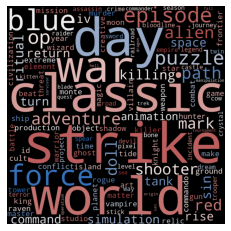

In [67]:
text = ' '.join(tfidf_df['Vocabulary'])

plt.rcParams['figure.figsize'] = (15, 15)
wordcloud = WordCloud(background_color='black', colormap='vlag',
                      width=1200, height=1200, max_words=121).generate(text)
plt.imshow(wordcloud)
plt.axis("off")
plt.show()


## **2.2 Count Vectorizer**

### **Count Vectorizer for Text Data**

The Count Vectorizer is a simple method used to convert text data into numerical feature vectors. It essentially counts the frequency of words in a document or corpus and transforms them into a matrix format.

- The Count Vectorizer simply counts the number of occurrences of each word in a document.
- It is a straightforward way to represent textual data in a format that can be fed into various algorithms.
- It creates a sparse matrix that represents the count of each term in the document.

### **Process of Count Vectorization**

1. **Tokenization:** The text is split into words, phrases, or sentences.
2. **Counting:** The count of each term is recorded.
3. **Matrix Formation:** The count of each term is used to create a matrix.

### **Example of Count Vectorizer**

Suppose we have the following documents:

```css
cssCopy code
["I love to learn", "Natural language processing is interesting", "Machine learning is fun"]

```

Using the Count Vectorizer, the words will be represented in the following matrix format:

```lua
luaCopy code
| "I" | "love" | "to" | "learn" | "natural" | "language" | "processing" | "is" | "interesting" | "machine" | "learning" | "fun" |
|-----|-------|-----|--------|----------|------------|--------------|-----|--------------|---------|-----------|------|
| 1   | 1     | 1   | 1      | 0        | 0          | 0            | 0   | 0            | 0       | 0         | 0    |
| 0   | 0     | 0   | 0      | 1        | 1          | 1            | 1   | 1            | 0       | 0         | 0    |
| 0   | 0     | 0   | 0      | 0        | 0          | 0            | 1   | 0            | 1       | 1         | 1    |

```

This count matrix can be used as input data for various machine learning algorithms.

Sources:

- [Scikit-learn Count Vectorizer](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html)

In [68]:
from sklearn.feature_extraction.text import CountVectorizer

In [69]:
time_start = time.time()

count_vectorizer = CountVectorizer(lowercase=True, stop_words='english')
count_vectorizer_matrix = count_vectorizer.fit_transform(df_rec['all'])

time_end = time.time()
print(
    f"CountVectorizer Vectorizer: {round(time_end - time_start, 2)} second")
print(f'CountVectorizer shape: {count_vectorizer_matrix.shape}')
feature_names = count_vectorizer.get_feature_names_out()
print("Feature Names (Terms):", feature_names)

stop_words = count_vectorizer.get_stop_words()
print("Stop Words:", stop_words)

vocabulary = count_vectorizer.vocabulary_
print("Vocabulary:", vocabulary)


CountVectorizer Vectorizer: 0.15 second
CountVectorizer shape: (13832, 19167)
Feature Names (Terms): ['000' '001' '005' ... 'zylon' 'zynk' 'zzzz']
Stop Words: frozenset({'with', 'be', 'he', 'detail', 'could', 'several', 'again', 'de', 'under', 'get', 'front', 'perhaps', 'after', 'per', 'some', 'ten', 'until', 'though', 'four', 'nine', 'whether', 'bottom', 'for', 'any', 'may', 'mostly', 'there', 'two', 'other', 'fifteen', 'fill', 'eight', 'amount', 'itself', 'sixty', 'part', 'call', 'either', 'over', 'the', 'con', 'mill', 'onto', 'we', 'less', 'thereupon', 'still', 'elsewhere', 'being', 'anywhere', 'latter', 'throughout', 'yet', 'describe', 'next', 'therefore', 'toward', 'bill', 'due', 'all', 'am', 'should', 'you', 'found', 'hasnt', 'ever', 'and', 'however', 'from', 'himself', 'as', 'through', 'name', 'between', 'while', 'eg', 'they', 'cannot', 'anything', 'such', 'beforehand', 'our', 'a', 'every', 'serious', 'whereupon', 'yours', 'five', 'these', 'becoming', 'made', 'whence', 'always',

In [70]:
count_df = pd.DataFrame([vocabulary])
count_df = pd.DataFrame(
    list(vocabulary.items()), columns=['Vocabulary', 'Count'])
count_df.sort_values(by='Count', ascending=False)


,Vocabulary,Count
11667,zzzz,19166
12709,zynk,19165
5189,zylon,19164
8901,zykov,19163
16855,zydrone,19162
...,...,...
17029,011,4
3762,01,3
13238,005,2
6500,001,1


### What is Vectorizer done looks like?

In [71]:
pd.DataFrame(count_vectorizer_matrix.toarray(),columns=count_vectorizer.get_feature_names_out())

,000,001,005,01,011,02,03,03m,04,07,...,zup,zut,zv,zwei,zwuggels,zydrone,zykov,zylon,zynk,zzzz
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13827,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
13828,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
13829,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
13830,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


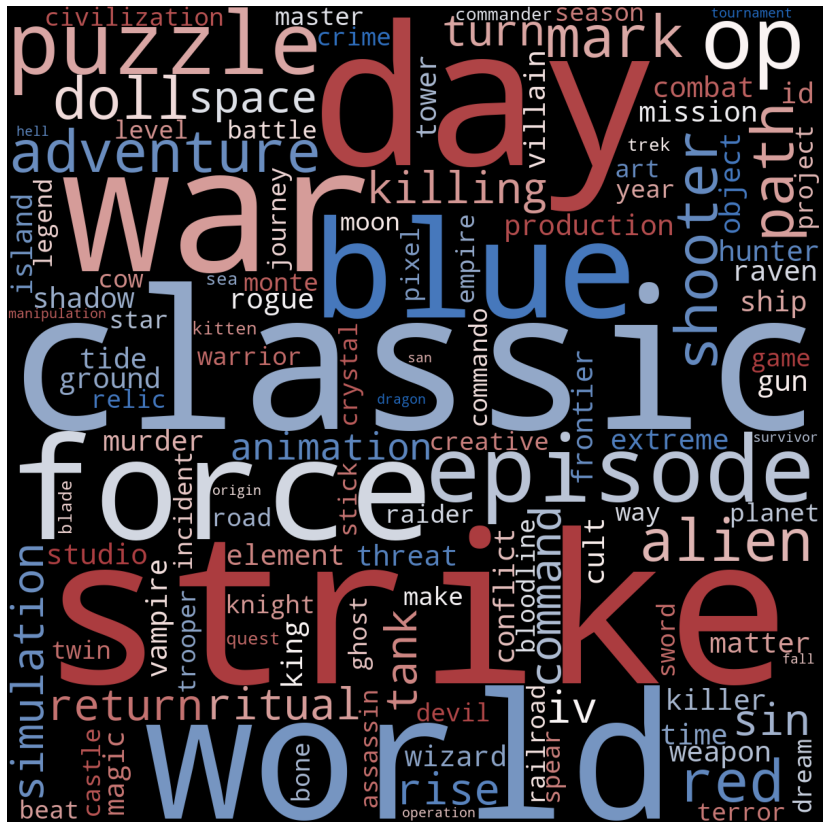

In [72]:
text = ' '.join(count_df['Vocabulary'])

plt.rcParams['figure.figsize'] = (15, 15)
wordcloud = WordCloud(background_color='black', colormap='vlag',
                      width=1200, height=1200, max_words=121).generate(text)
plt.imshow(wordcloud)
plt.axis("off")
plt.show()


# 3. **Exploratory Data Analysis (EDA)**:
- Conduct EDA to gain insights into the dataset, such as game popularity, distribution of genres, categories, tags, and player reviews.
- Visualize key statistics and distributions using plots and graphs.
- Identify correlations and patterns in the data.

In [73]:
steam.select_dtypes(include=['int64', 'float64']).describe().T

,count,mean,std,min,25%,50%,75%,max
steam_appid,27075.0,596203.508661,250894.167246,10.0,401230.00,599070.00,798760.00,1069460.00
english,27075.0,0.981127,0.136081,0.0,1.00,1.00,1.00,1.00
required_age,27075.0,0.354903,2.406044,0.0,0.00,0.00,0.00,18.00
achievements,27075.0,45.248864,352.670281,0.0,0.00,7.00,23.00,9821.00
positive_ratings,27075.0,1000.558523,18988.724439,0.0,6.00,24.00,126.00,2644404.00
negative_ratings,27075.0,211.027147,4284.938531,0.0,2.00,9.00,42.00,487076.00
average_playtime,27075.0,149.804949,1827.038141,0.0,0.00,0.00,0.00,190625.00
median_playtime,27075.0,146.056030,2353.880080,0.0,0.00,0.00,0.00,190625.00
price,27075.0,6.078193,7.874922,0.0,1.69,3.99,7.19,421.99


c:\Users\Windows10\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\axisgrid.py:1544: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(x=data_k, label=label_k, color=color, **plot_kwargs)
c:\Users\Windows10\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\axisgrid.py:1544: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de

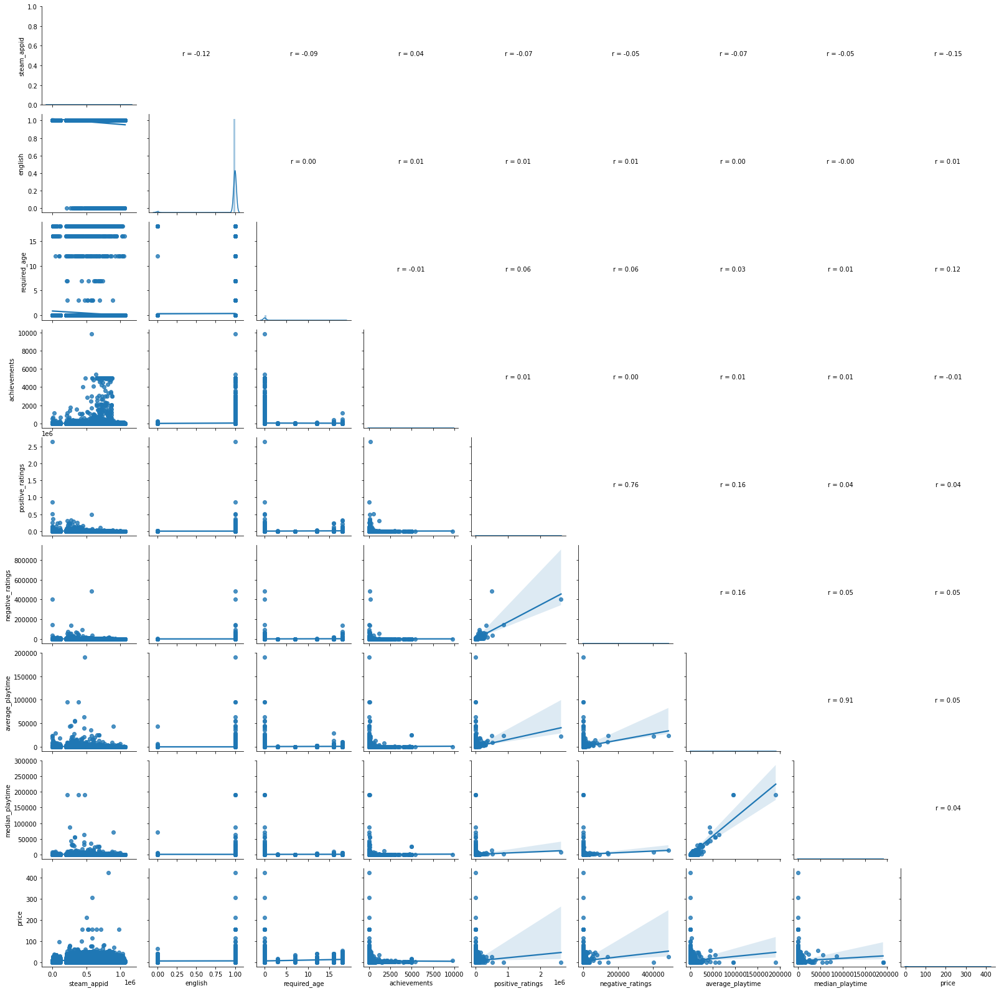

In [74]:
from scipy.stats import pearsonr


def reg_coef(x, y, label=None, color=None, **kwargs):
    ax = plt.gca()
    r, p = pearsonr(x, y)
    ax.annotate('r = {:.2f}'.format(r), xy=(0.5, 0.5),
                xycoords='axes fraction', ha='center')
    ax.set_axis_off()


g = sns.PairGrid(steam[numeric_cols])
g.map_diag(sns.distplot)
g.map_lower(sns.regplot)
g.map_upper(reg_coef)


In [75]:
def count_category(data):
  dicts = {}
  for x in data:
    for y in x:
      if y not in dicts.keys():
        dicts[y] = 0
      dicts[y] = int(dicts[y])+1
  return dicts

In [76]:
categories = steam['categories'].str.split(";")
categories = count_category(categories)
categories

{'Multi-player': 3974,
 'Online Multi-Player': 2487,
 'Local Multi-Player': 1615,
 'Valve Anti-Cheat enabled': 94,
 'Single-player': 25678,
 'Steam Cloud': 7219,
 'Steam Achievements': 14130,
 'Steam Trading Cards': 7918,
 'Captions available': 721,
 'Partial Controller Support': 4234,
 'Includes Source SDK': 35,
 'Cross-Platform Multiplayer': 1081,
 'Stats': 1878,
 'Commentary available': 144,
 'Includes level editor': 1036,
 'Steam Workshop': 897,
 'In-App Purchases': 690,
 'Co-op': 1721,
 'Full controller support': 5695,
 'Steam Leaderboards': 3439,
 'SteamVR Collectibles': 40,
 'Online Co-op': 1071,
 'Shared/Split Screen': 2152,
 'Local Co-op': 1059,
 'MMO': 421,
 'VR Support': 231,
 'Mods': 2,
 'Mods (require HL2)': 1,
 'Steam Turn Notifications': 63}

In [77]:
genres = steam['genres'].str.split(";")
genres = count_category(genres)
genres


{'Action': 11903,
 'Free to Play': 1704,
 'Strategy': 5247,
 'Adventure': 10032,
 'Indie': 19421,
 'RPG': 4311,
 'Animation & Modeling': 79,
 'Video Production': 38,
 'Casual': 10210,
 'Simulation': 5194,
 'Racing': 1024,
 'Violent': 843,
 'Massively Multiplayer': 723,
 'Nudity': 266,
 'Sports': 1322,
 'Early Access': 2954,
 'Gore': 537,
 'Utilities': 146,
 'Design & Illustration': 87,
 'Web Publishing': 28,
 'Education': 51,
 'Software Training': 31,
 'Sexual Content': 245,
 'Audio Production': 29,
 'Game Development': 17,
 'Photo Editing': 12,
 'Accounting': 6,
 'Documentary': 1,
 'Tutorial': 1}

In [78]:
steamspy_tags = steam['steamspy_tags'].str.split(";")
steamspy_tags = count_category(steamspy_tags)
steamspy_tags


{'Action': 10322,
 'FPS': 405,
 'Multiplayer': 405,
 'World War II': 130,
 'Sci-fi': 157,
 'Classic': 170,
 'Singleplayer': 161,
 'Puzzle': 1116,
 'First-Person': 91,
 'Free to Play': 1662,
 'Zombies': 158,
 'Co-op': 120,
 'MOBA': 13,
 'Strategy': 4173,
 'Shooter': 101,
 'Indie': 16232,
 'Fighting': 117,
 'Cyberpunk': 58,
 'RTS': 174,
 'Hacking': 20,
 'Simulation': 3284,
 'Naval': 39,
 '4X': 37,
 'Turn-Based Strategy': 103,
 'Fantasy': 115,
 'Tanks': 21,
 'Space': 225,
 'RPG': 2785,
 'Animation & Modeling': 54,
 'Video Production': 31,
 'Open World': 243,
 'Competitive': 12,
 'Top-Down Shooter': 27,
 'Casual': 8205,
 'Vampire': 17,
 'Cult Classic': 7,
 'Western': 23,
 'Racing': 765,
 'Destruction': 21,
 'Offroad': 17,
 'Adventure': 7770,
 'Match 3': 119,
 'Arcade': 203,
 'Hidden Object': 460,
 'Tower Defense': 168,
 'Sniper': 8,
 'Stealth': 93,
 'Base-Building': 26,
 'Villain Protagonist': 9,
 'Story Rich': 159,
 'Female Protagonist': 199,
 'Platformer': 648,
 'Comedy': 89,
 'Turn-Base

In [79]:
categories_df = pd.DataFrame([categories])
categories_df = pd.DataFrame(list(categories.items()), columns=['Category', 'Count'])
categories_df


,Category,Count
0,Multi-player,3974
1,Online Multi-Player,2487
2,Local Multi-Player,1615
3,Valve Anti-Cheat enabled,94
4,Single-player,25678
5,Steam Cloud,7219
6,Steam Achievements,14130
7,Steam Trading Cards,7918
8,Captions available,721
9,Partial Controller Support,4234


In [80]:
genre_df = pd.DataFrame([genres])
genre_df = pd.DataFrame(
    list(genres.items()), columns=['Genres', 'Count'])
genre_df


,Genres,Count
0,Action,11903
1,Free to Play,1704
2,Strategy,5247
3,Adventure,10032
4,Indie,19421
5,RPG,4311
6,Animation & Modeling,79
7,Video Production,38
8,Casual,10210
9,Simulation,5194


In [81]:
steamspy_tags_df = pd.DataFrame([steamspy_tags])
steamspy_tags_df = pd.DataFrame(
    list(steamspy_tags.items()), columns=['Steamspy_tags', 'Count'])
steamspy_tags_df

,Steamspy_tags,Count
0,Action,10322
1,FPS,405
2,Multiplayer,405
3,World War II,130
4,Sci-fi,157
...,...,...
334,2.5D,1
335,Blood,1
336,NSFW,1
337,Stylized,1


In [82]:
import matplotlib.pyplot as plt

In [83]:
def plot_bar_chart(dataframe, x_col, y_col, title, x_label, y_label, rotation=0, top=10):
    df_sorted = dataframe.sort_values(by=y_col, ascending=False).head(top)

    plt.figure(figsize=(12, 6))
    bars = plt.bar(df_sorted[x_col], df_sorted[y_col])
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.title(title+ f' (Dispaly Top {top})')
    # Rotate x-axis labels for better readability
    plt.xticks(rotation=rotation)

    for bar in bars:
        height = bar.get_height()
        plt.annotate('{}'.format(height),
                     xy=(bar.get_x() + bar.get_width() / 2, height),
                     xytext=(0, 3),  # 3 points vertical offset
                     textcoords="offset points",
                     ha='center', va='bottom')

    plt.show()


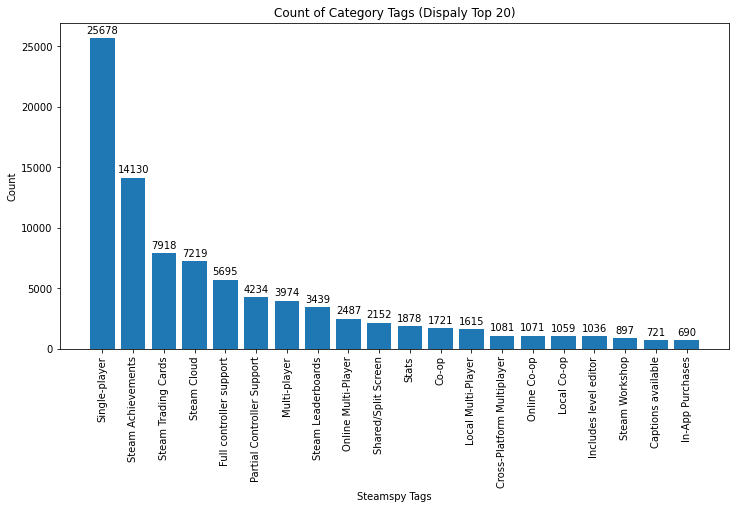

In [84]:
plot_bar_chart(dataframe=categories_df,
               x_col='Category',
               y_col='Count',
               title='Count of Category Tags',
               x_label='Steamspy Tags',
               y_label='Count',
               rotation=90, 
               top=20)


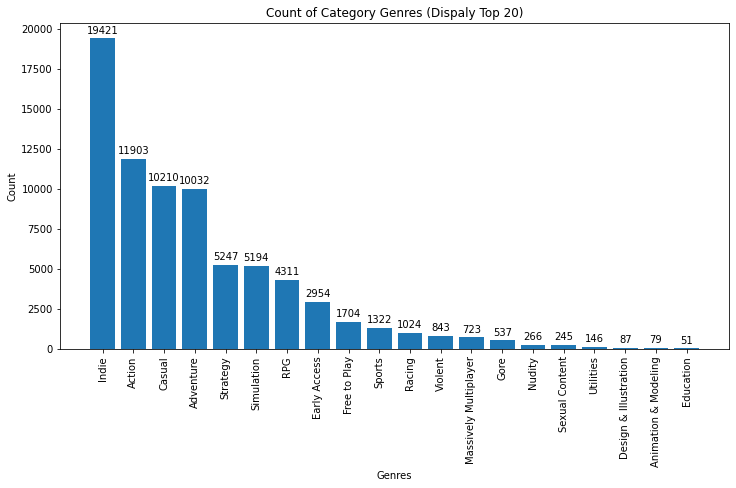

In [85]:
plot_bar_chart(dataframe=genre_df,
               x_col='Genres',
               y_col='Count',
               title='Count of Category Genres',
               x_label='Genres',
               y_label='Count',
               rotation=90,
               top=20)


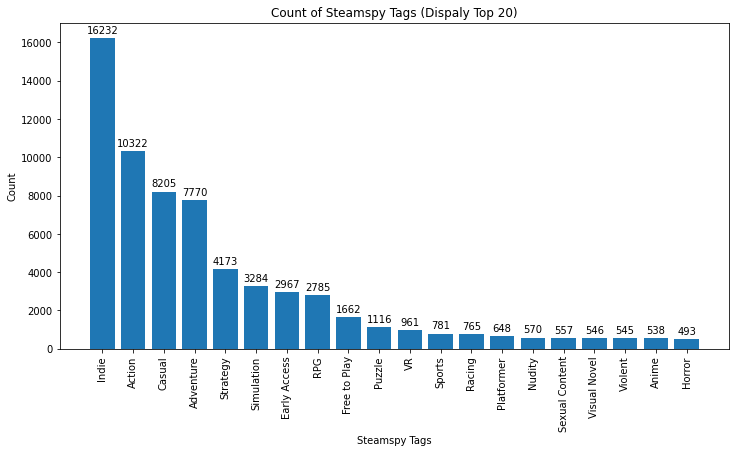

In [86]:
plot_bar_chart(dataframe=steamspy_tags_df,
               x_col='Steamspy_tags',
               y_col='Count',
               title='Count of Steamspy Tags',
               x_label='Steamspy Tags',
               y_label='Count',
               rotation=90,
               top=20)


# 4. **Modeling**:
We use two methods for similarity calculation: **Linear Kernel** and **Cosine Similarity**.

## Content-Based Similarity
In the context of a content-based recommendation system, we utilize two primary methods for measuring similarity between different items:

- **Linear Kernel** measures the linear relationship between different data points. In the context of our content-based recommendation system, the linear kernel helps assess the relationship between different game attributes and features, enabling the identification of games with similar characteristics.


- **Cosine Similarity** is the measure of similarity between two vectors, Similarity between two vectors (A and B) is calculated by taking the dot product of the two vectors and dividing it by the magnitude value. 

In [87]:
from sklearn.metrics.pairwise import linear_kernel
from sklearn.metrics.pairwise import cosine_similarity

In [88]:
# Optional
from IPython.display import display, HTML
import time


## Benchmarking

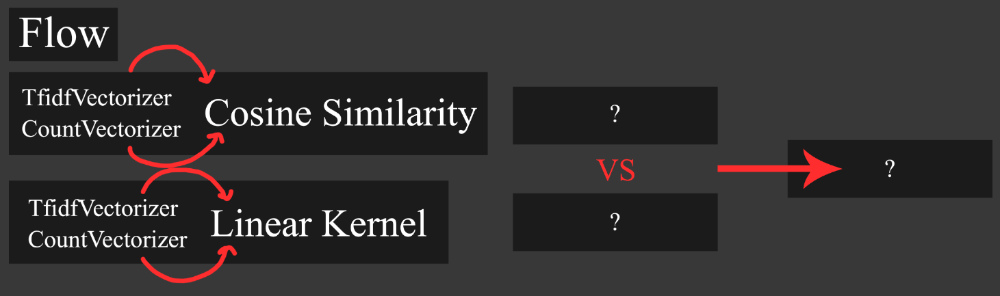

Consine Similarity
- TF-IDF Vectorizer 
- Count Vectorizer

In [89]:
tfidf_matrix.shape

(13832, 19167)

In [90]:
count_vectorizer_matrix.shape

(13832, 19167)

In [91]:
time_start = time.time()

cosine_TfidV = cosine_similarity(tfidf_matrix, tfidf_matrix)
time_end = time.time()
print(f"Cosine Similarity + TF-IDF Vectorizer: {round(time_end - time_start, 2)} second")
cosine_TfidV.shape

Cosine Similarity + TF-IDF Vectorizer: 2.71 second


(13832, 13832)

In [92]:
time_start = time.time()

cosine_countV = cosine_similarity(
    count_vectorizer_matrix, count_vectorizer_matrix)

time_end = time.time()
print(f"Cosine Similarity + Count Vectorizer: {round(time_end - time_start, 2)} second")
cosine_countV.shape


Cosine Similarity + Count Vectorizer: 3.49 second


(13832, 13832)

Linear Kernel
- TF-IDF Vectorizer 
- Count Vectorizer

In [93]:
time_start = time.time()

linear_kernel_TfidV = linear_kernel(tfidf_matrix, tfidf_matrix)
time_end = time.time()
print(
    f"Linear kernel + TF-IDF Vectorizer: {round(time_end - time_start, 2)} second")
linear_kernel_TfidV.shape


Linear kernel + TF-IDF Vectorizer: 4.51 second


(13832, 13832)

In [94]:
time_start = time.time()

linear_kernel_countV = linear_kernel(
    count_vectorizer_matrix, count_vectorizer_matrix)
time_end = time.time()
print(
    f"Linear kernel + Count Vectorizer: {round(time_end - time_start, 2)} second")
linear_kernel_countV.shape


Linear kernel + Count Vectorizer: 17.44 second


(13832, 13832)

In [95]:
def nearest_name(name: str, verbose=1):
    result = merged_df[merged_df['name'].str.startswith(name[:-1])]
    close = get_close_matches(name)
    if verbose==1:
        display(HTML(result[['name', 'developer', 'genres','steamspy_tags']].to_html()))
    if len(result) != 0:
        return result.index[0]
    elif close:
        return close[0]
    else:
        return None
    

def get_close_matches(name: str):
    result = merged_df.loc[merged_df['name'].apply(
        lambda x: x.lower()).str.contains(name.lower())]
        
    if len(result) != 0:
        return result
    return []


Criterion of benchmarking:
- Name correction
- Time Performance

In [140]:
a_game = "Counter-Strike"
b_game = "Half-Life"
c_game = "Tom Clancy's Rainbow Six"

In [141]:
nearest_name(name=a_game)

,name,developer,genres,steamspy_tags
0,Counter-Strike,Valve,Action,Action;FPS;Multiplayer
7,Counter-Strike: Condition Zero,Valve,Action,Action;FPS;Multiplayer
10,Counter-Strike: Source,Valve,Action,Action;FPS;Multiplayer
25,Counter-Strike: Global Offensive,Valve;Hidden Path Entertainment,Action;Free to Play,FPS;Multiplayer;Shooter
2093,Counter-Strike Nexon: Zombies,"Valve Corporation, Nexon Korea Corporation",Action;Casual;Free to Play;Massively Multiplayer,Free to Play;Zombies;Multiplayer


0

In [142]:
nearest_name(name=b_game)


,name,developer,genres,steamspy_tags
4,Half-Life: Opposing Force,Gearbox Software,Action,FPS;Action;Sci-fi
6,Half-Life,Valve,Action,FPS;Classic;Action
8,Half-Life: Blue Shift,Gearbox Software,Action,FPS;Action;Sci-fi
9,Half-Life 2,Valve,Action,FPS;Action;Sci-fi
11,Half-Life: Source,Valve,Action,FPS;Action;Sci-fi
13,Half-Life 2: Deathmatch,Valve,Action,Action;FPS;Multiplayer
14,Half-Life 2: Lost Coast,Valve,Action,FPS;Action;Singleplayer
15,Half-Life Deathmatch: Source,Valve,Action,Action;FPS;Multiplayer
16,Half-Life 2: Episode One,Valve,Action,FPS;Action;Sci-fi
18,Half-Life 2: Episode Two,Valve,Action,FPS;Action;Sci-fi


4

In [143]:
nearest_name(name=c_game)


,name,developer,genres,steamspy_tags
292,Tom Clancy's Rainbow Six® Vegas,Ubisoft Montreal,Action,Action;FPS;Tactical
299,Tom Clancy's Rainbow Six® Vegas 2,Ubisoft Montreal,Action,Action;Tactical;FPS
375,Tom Clancy's Rainbow Six® 3 Gold,Red Storm Entertainment;Ubisoft Montreal,Action,Tactical;FPS;Action
4079,Tom Clancy's Rainbow Six® Siege,Ubisoft Montreal,Action,FPS;Multiplayer;Tactical


292

## Similarity function
have 2 functions consist: 
- similarity with nearest name = figure out itself and find the closest name
- similarity with indice = required the exact name in DataFrame

In [150]:
# similarity_nearest_name is figure out itself and find the closest name
def similarity_nearest_name(name: str, similarity_vectorizer):

    ind = nearest_name(name=name,verbose=0)
    cos_score = list(enumerate(similarity_vectorizer[ind]))

    cos_score = sorted(cos_score, key=lambda x: x[1], reverse=True)
    cos_score = cos_score[0:10]
    ten_ind = [i[0] for i in cos_score]
    df = df_rec[['name', 'developer', 'genres&tags']].iloc[ten_ind]

    score = [i[1] for i in cos_score]
    score = [round(num, 4) for num in score]

    df = pd.DataFrame({'name': df['name'],
                       'developer': df['developer'],
                       'genres&tags': df['genres&tags'],
                       'match_score': score
                       })
    average_match_score = df['match_score'].mean()
    print(f'Average Match Score: {average_match_score:.4f}')
    return df

In [151]:
# similarity_indices is required the exact name in DataFrame
def similarity_indices(name: str, similarity_vectorizer):
    indices = pd.Series(df_rec.index, index=df_rec['name'])

    ind = indices[name]
    cos_score = list(enumerate(similarity_vectorizer[ind]))

    cos_score = sorted(cos_score, key=lambda x: x[1], reverse=True)
    cos_score = cos_score[0:10]
    ten_ind = [i[0] for i in cos_score]
    df = df_rec[['name', 'developer', 'genres&tags']].iloc[ten_ind]

    score = [i[1] for i in cos_score]
    score = [round(num, 4) for num in score]

    df = pd.DataFrame({'name': df['name'],
                       'developer': df['developer'],
                       'genres&tags': df['genres&tags'],
                       'match_score': score
                       })
    average_match_score = df['match_score'].mean()
    print(f'Average Match Score: {average_match_score:.4f}')
    return df

# Cosine Similarity + TF-IDF Vectorizer

In [152]:
similarity_nearest_name(name=a_game, similarity_vectorizer=cosine_TfidV)

Average Match Score: 0.5919


,name,developer,genres&tags,match_score
0,counter strike,valve,action fps multiplayer,1.0000
10,counter strike source,valve,action fps multiplayer,0.8677
7,counter strike condition zero,valve,action fps multiplayer,0.7871
25,counter strike global offensive,valve hidden path entertainment,action free play fps multiplayer shooter,0.6356
5,ricochet,valve,action fps multiplayer,0.4786
3,deathmatch classic,valve,action fps multiplayer,0.4559
19,team fortress 2,valve,action free play multiplayer fps,0.4433
1,team fortress classic,valve,action fps multiplayer,0.4386
2093,counter strike nexon zombies,valve corporation nexon korea corporation,action casual free play massively multiplayer ...,0.4176
13,half life 2 deathmatch,valve,action fps multiplayer,0.3951


# Cosine Similarity + Count Vectorizer

In [154]:
similarity_nearest_name(name=a_game, similarity_vectorizer=cosine_countV)


Average Match Score: 0.7233


,name,developer,genres&tags,match_score
0,counter strike,valve,action fps multiplayer,1.0000
10,counter strike source,valve,action fps multiplayer,0.9258
7,counter strike condition zero,valve,action fps multiplayer,0.8660
5,ricochet,valve,action fps multiplayer,0.7303
3,deathmatch classic,valve,action fps multiplayer,0.6667
25,counter strike global offensive,valve hidden path entertainment,action free play fps multiplayer shooter,0.6547
1,team fortress classic,valve,action fps multiplayer,0.6172
13,half life 2 deathmatch,valve,action fps multiplayer,0.6172
15,half life deathmatch source,valve,action fps multiplayer,0.5774
19,team fortress 2,valve,action free play multiplayer fps,0.5774


# Linear  Similarity + TF-IDF Vectorizer

In [155]:
similarity_nearest_name(name=a_game, similarity_vectorizer=linear_kernel_TfidV)


Average Match Score: 0.5919


,name,developer,genres&tags,match_score
0,counter strike,valve,action fps multiplayer,1.0000
10,counter strike source,valve,action fps multiplayer,0.8677
7,counter strike condition zero,valve,action fps multiplayer,0.7871
25,counter strike global offensive,valve hidden path entertainment,action free play fps multiplayer shooter,0.6356
5,ricochet,valve,action fps multiplayer,0.4786
3,deathmatch classic,valve,action fps multiplayer,0.4559
19,team fortress 2,valve,action free play multiplayer fps,0.4433
1,team fortress classic,valve,action fps multiplayer,0.4386
2093,counter strike nexon zombies,valve corporation nexon korea corporation,action casual free play massively multiplayer ...,0.4176
13,half life 2 deathmatch,valve,action fps multiplayer,0.3951


# Linear Similarity + Count Vectorizer

In [161]:
similarity_nearest_name(name=a_game, similarity_vectorizer=linear_kernel_countV)

Average Match Score: 4.9000


,name,developer,genres&tags,match_score
0,counter strike,valve,action fps multiplayer,6.0
7,counter strike condition zero,valve,action fps multiplayer,6.0
10,counter strike source,valve,action fps multiplayer,6.0
25,counter strike global offensive,valve hidden path entertainment,action free play fps multiplayer shooter,6.0
2093,counter strike nexon zombies,valve corporation nexon korea corporation,action casual free play massively multiplayer ...,5.0
1,team fortress classic,valve,action fps multiplayer,4.0
2,day defeat,valve,action fps world war ii multiplayer,4.0
3,deathmatch classic,valve,action fps multiplayer,4.0
5,ricochet,valve,action fps multiplayer,4.0
12,day defeat source,valve,action fps world war ii multiplayer,4.0


# 5. **Recommendation Algorithm**:
- Use the similarity matrix to implement a content-based recommendation algorithm. The algorithm can follow these steps:
    - For a given game, calculate its similarity scores with all other games in the dataset.
    - Select the top N games with the highest similarity scores as recommendations.
    - Filter out games the user has already interacted with or owns.
    - Present the recommended games to the user.

In [103]:
import requests
from PIL import Image
from io import BytesIO

In [104]:
def recommendations(name: str, similarity_vectorizer):

    ind = nearest_name(name=name, verbose=0)
    cos_score = list(enumerate(similarity_vectorizer[ind]))

    cos_score = sorted(cos_score, key=lambda x: x[1], reverse=True)
    cos_score = cos_score[0:10]
    ten_ind = [i[0] for i in cos_score]
    df = merged_df[['name', 'developer',  'genres',
                    'steamspy_tags',
                 'header_image']].iloc[ten_ind]
    score = [i[1] for i in cos_score]
    score = [round(num, 4) for num in score]

    df = pd.DataFrame({'name': df['name'],
                       'developer': df['developer'],
                       'genres': df['genres'],
                       'steamspy_tags':df['steamspy_tags'],
                       'header_image': df['header_image'],
                       'match_score': score
                       })

    for index, row in df.iterrows():
        plt.figure(figsize=(1, 1))
        response = requests.get(row['header_image'])
        img = Image.open(BytesIO(response.content))
       
        plt.figure()
        plt.imshow(img)
        plt.title(r'$\bf{' +df['name'].loc[index] + '}$' +
                  f"\nMatch score: {df['match_score'].loc[index]}\nDeveloper: {df['developer'].loc[index]}\nGenres: {df['genres'].loc[index]}\nTags: {df['steamspy_tags'].loc[index]}")
        plt.xlabel(df['match_score'].loc[index])

        plt.show()
    average_match_score = df['match_score'].mean()
    print(f'Average Match Score: {average_match_score:.4f}')
    return df[['name', 'developer',  'genres',
               'steamspy_tags','match_score']]


In [105]:
merged_df.sort_values(by='positive_ratings', ascending=False).head()

,steam_appid,name,release_date,english,developer,publisher,platforms,required_age,categories,genres,...,owners,price,detailed_description,about_the_game,short_description,header_image,screenshots,background,movies,total_ratings
25,730,Counter-Strike: Global Offensive,2012-08-21,1,Valve;Hidden Path Entertainment,Valve,windows;mac;linux,0,Multi-player;Steam Achievements;Full controlle...,Action;Free to Play,...,50000000-100000000,0.00,Counter-Strike: Global Offensive (CS: GO) expa...,Counter-Strike: Global Offensive (CS: GO) expa...,Counter-Strike: Global Offensive (CS: GO) expa...,https://steamcdn-a.akamaihd.net/steam/apps/730...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/730...,"[{'id': 81958, 'name': 'CS:GO Trailer Long', '...",2242091
22,570,Dota 2,2013-07-09,1,Valve,Valve,windows;mac;linux,0,Multi-player;Co-op;Steam Trading Cards;Steam W...,Action;Free to Play;Strategy,...,100000000-200000000,0.00,<strong>The most-played game on Steam.</strong...,<strong>The most-played game on Steam.</strong...,"Every day, millions of players worldwide enter...",https://steamcdn-a.akamaihd.net/steam/apps/570...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/570...,"[{'id': 256692021, 'name': 'Dota 2 - Join the ...",721428
19,440,Team Fortress 2,2007-10-10,1,Valve,Valve,windows;mac;linux,0,Multi-player;Cross-Platform Multiplayer;Steam ...,Action;Free to Play,...,20000000-50000000,0.00,"<h1>The Jungle Inferno Update</h1><p><a href=""...","<p><strong>""The most fun you can have online""<...",Nine distinct classes provide a broad range of...,https://steamcdn-a.akamaihd.net/steam/apps/440...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/440...,"[{'id': 256698790, 'name': 'Jungle Inferno', '...",481843
8752,578080,PLAYERUNKNOWN'S BATTLEGROUNDS,2017-12-21,1,PUBG Corporation,PUBG Corporation,windows,0,Multi-player;Online Multi-Player;Stats,Action;Adventure;Massively Multiplayer,...,50000000-100000000,26.99,<strong>PLAYERUNKNOWN'S BATTLEGROUNDS</strong>...,<strong>PLAYERUNKNOWN'S BATTLEGROUNDS</strong>...,PLAYERUNKNOWN'S BATTLEGROUNDS is a battle roya...,https://steamcdn-a.akamaihd.net/steam/apps/578...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/578...,"[{'id': 256737984, 'name': 'Vikendi CGI Traile...",9108
112,4000,Garry's Mod,2006-11-29,1,Facepunch Studios,Valve,windows;mac;linux,0,Single-player;Multi-player;Co-op;Cross-Platfor...,Indie;Simulation,...,10000000-20000000,6.99,Garry's Mod is a physics sandbox. There aren't...,Garry's Mod is a physics sandbox. There aren't...,Garry's Mod is a physics sandbox. There aren't...,https://steamcdn-a.akamaihd.net/steam/apps/400...,"[{'id': 0, 'path_thumbnail': 'https://steamcdn...",https://steamcdn-a.akamaihd.net/steam/apps/400...,NaN,347288


<Figure size 72x72 with 0 Axes>

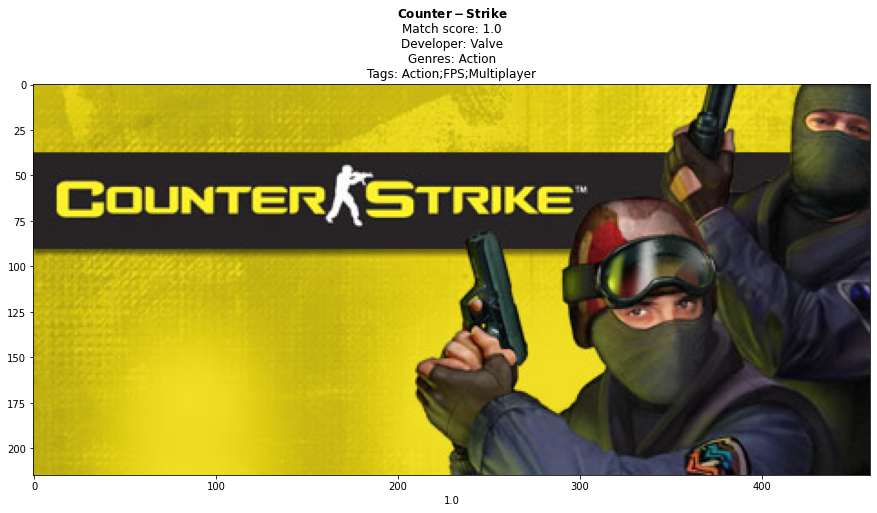

<Figure size 72x72 with 0 Axes>

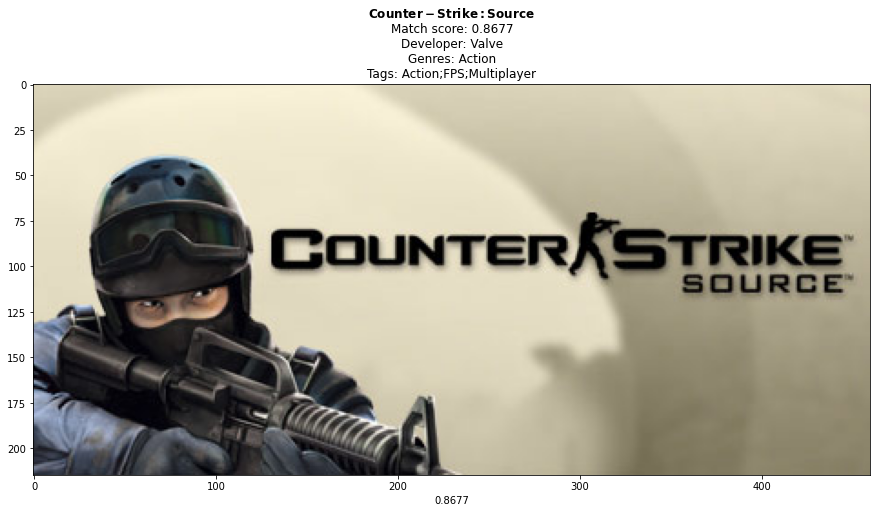

<Figure size 72x72 with 0 Axes>

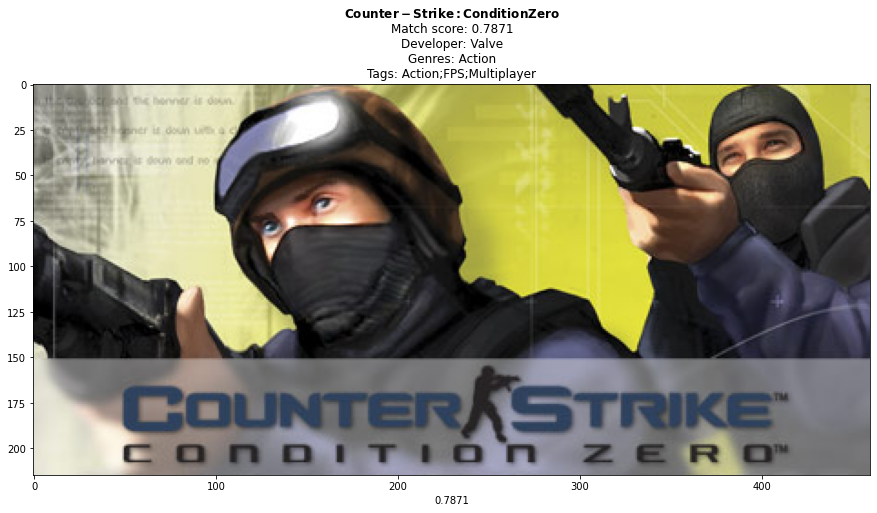

<Figure size 72x72 with 0 Axes>

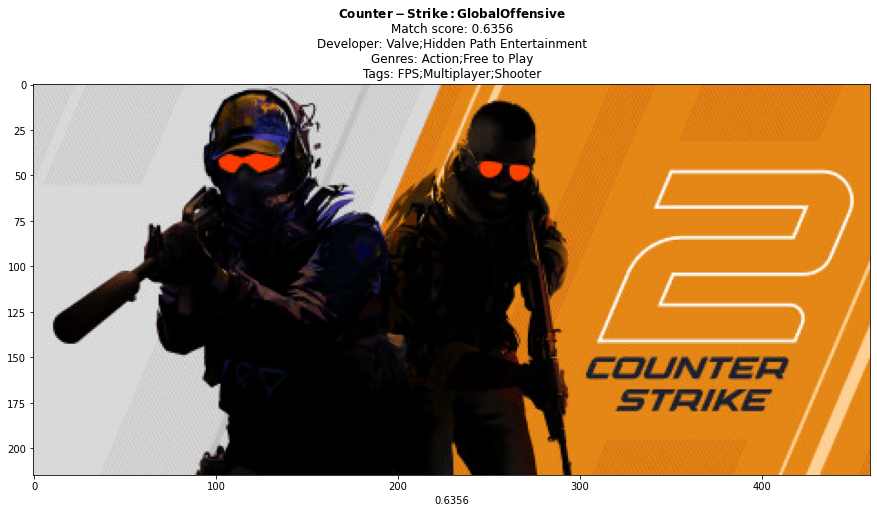

<Figure size 72x72 with 0 Axes>

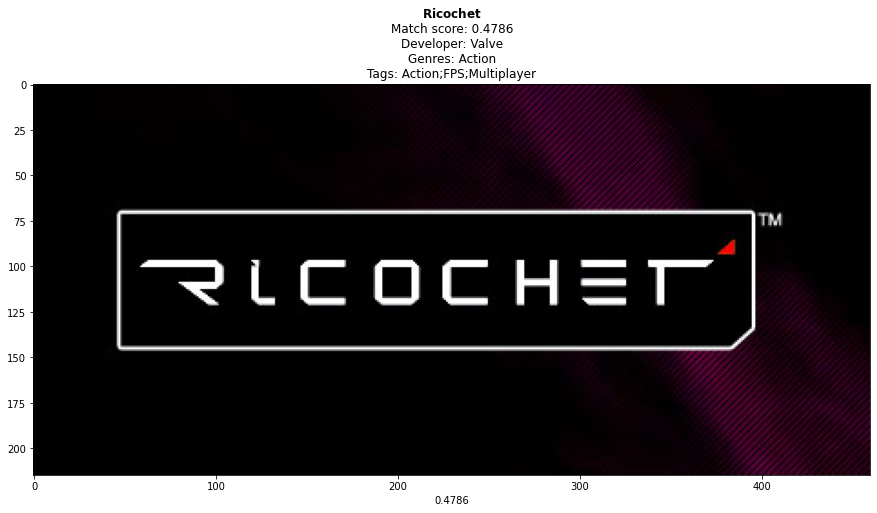

<Figure size 72x72 with 0 Axes>

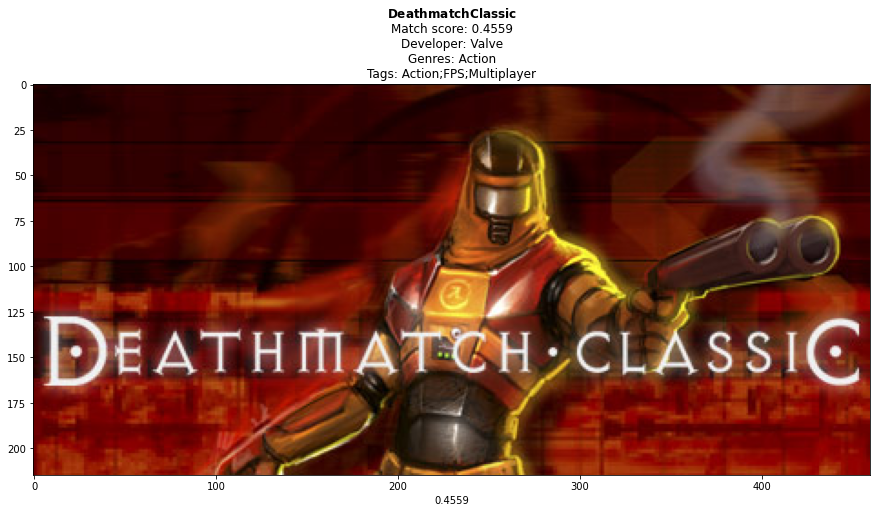

<Figure size 72x72 with 0 Axes>

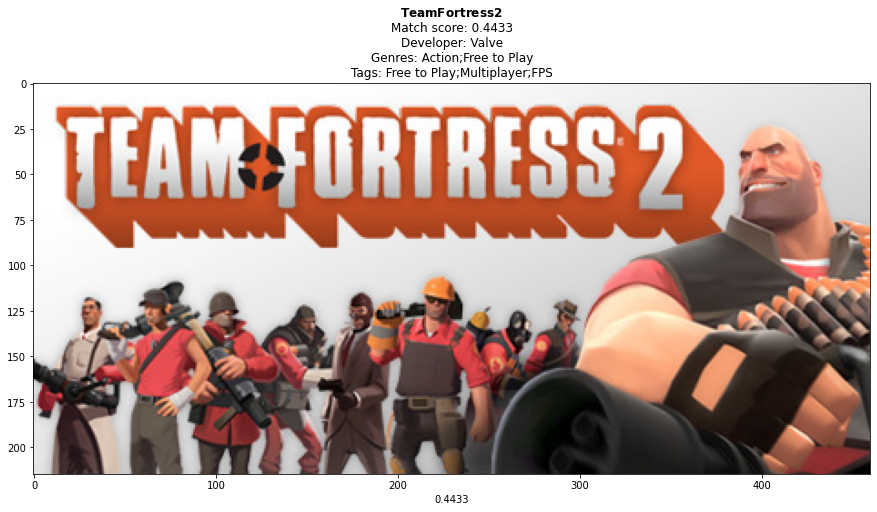

<Figure size 72x72 with 0 Axes>

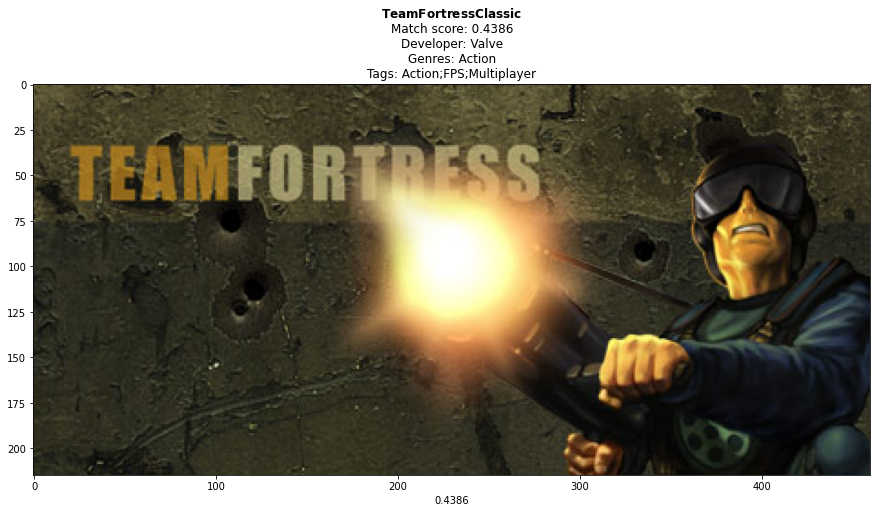

<Figure size 72x72 with 0 Axes>

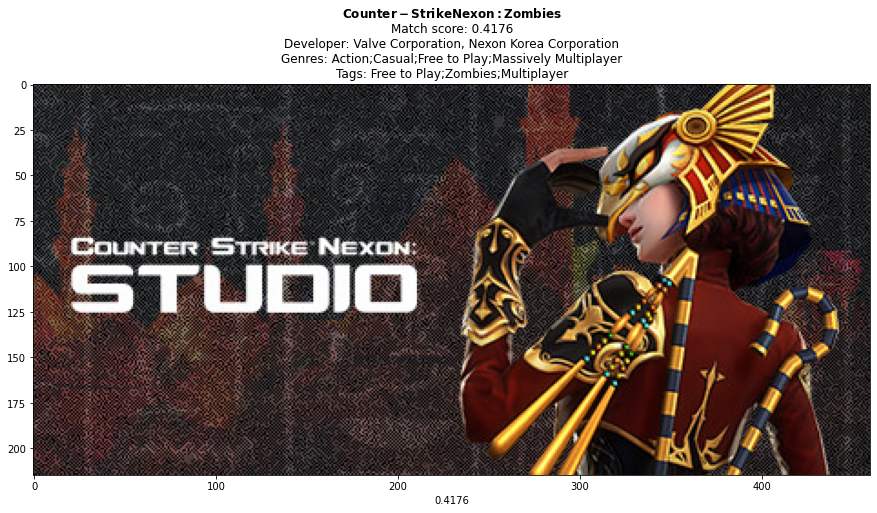

<Figure size 72x72 with 0 Axes>

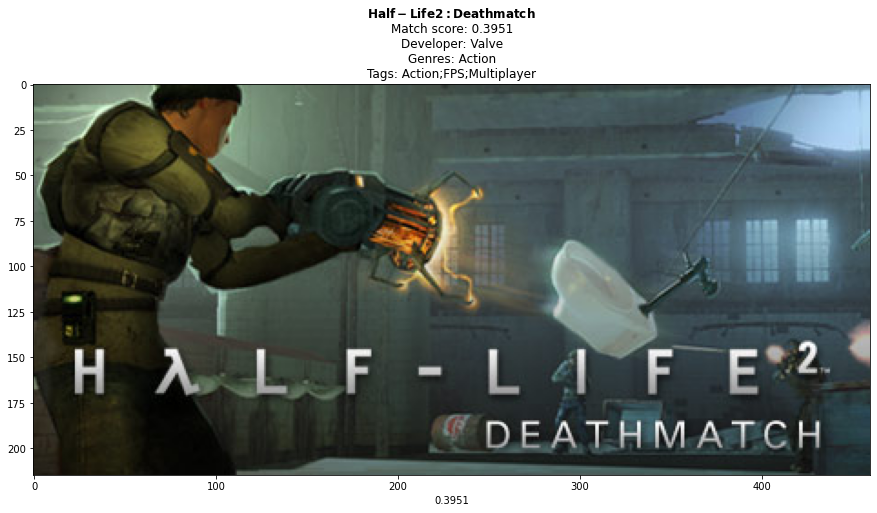

Average Match Score: 0.5919


,name,developer,genres,steamspy_tags,match_score
0,Counter-Strike,Valve,Action,Action;FPS;Multiplayer,1.0000
10,Counter-Strike: Source,Valve,Action,Action;FPS;Multiplayer,0.8677
7,Counter-Strike: Condition Zero,Valve,Action,Action;FPS;Multiplayer,0.7871
25,Counter-Strike: Global Offensive,Valve;Hidden Path Entertainment,Action;Free to Play,FPS;Multiplayer;Shooter,0.6356
5,Ricochet,Valve,Action,Action;FPS;Multiplayer,0.4786
3,Deathmatch Classic,Valve,Action,Action;FPS;Multiplayer,0.4559
19,Team Fortress 2,Valve,Action;Free to Play,Free to Play;Multiplayer;FPS,0.4433
1,Team Fortress Classic,Valve,Action,Action;FPS;Multiplayer,0.4386
2093,Counter-Strike Nexon: Zombies,"Valve Corporation, Nexon Korea Corporation",Action;Casual;Free to Play;Massively Multiplayer,Free to Play;Zombies;Multiplayer,0.4176
13,Half-Life 2: Deathmatch,Valve,Action,Action;FPS;Multiplayer,0.3951


In [106]:
game_name = "Counter-Strike"
recommendations(name=game_name, similarity_vectorizer=cosine_TfidV)

<Figure size 72x72 with 0 Axes>

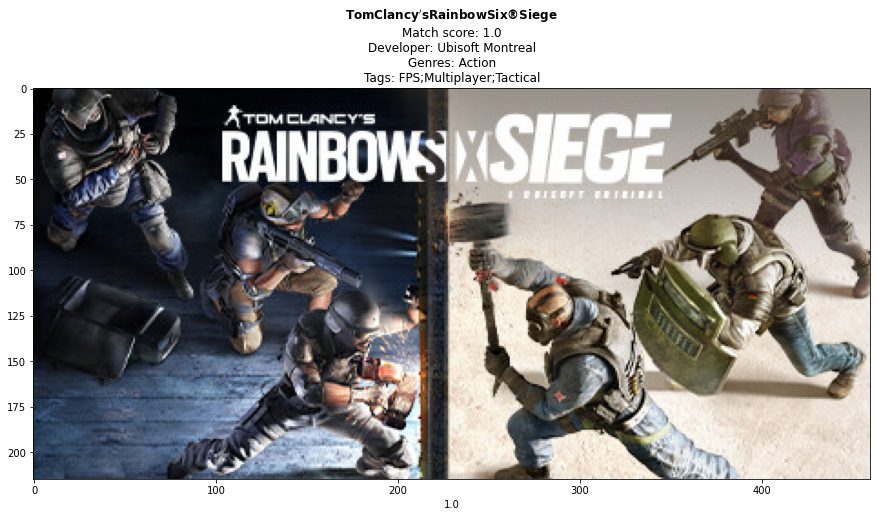

<Figure size 72x72 with 0 Axes>

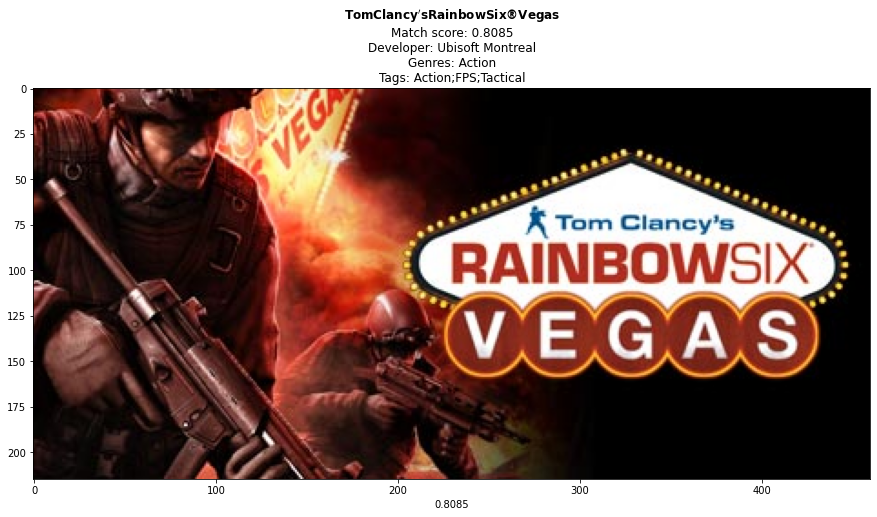

<Figure size 72x72 with 0 Axes>

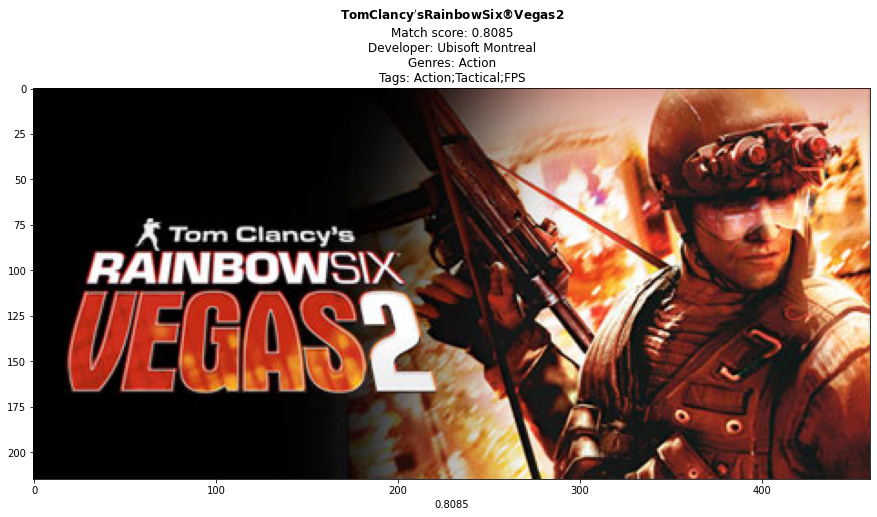

<Figure size 72x72 with 0 Axes>

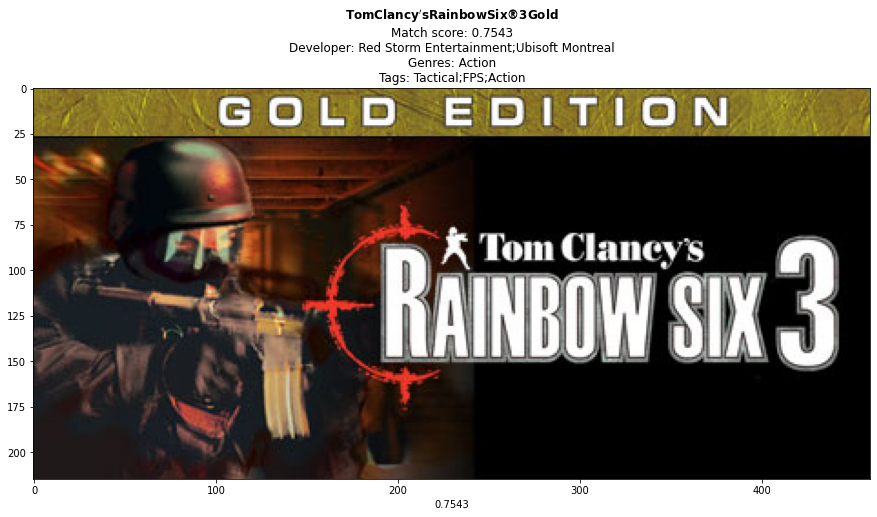

<Figure size 72x72 with 0 Axes>

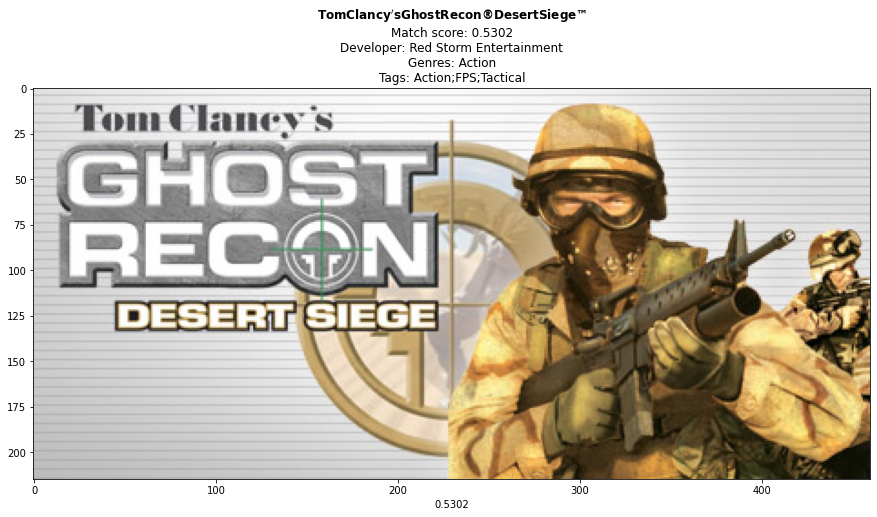

<Figure size 72x72 with 0 Axes>

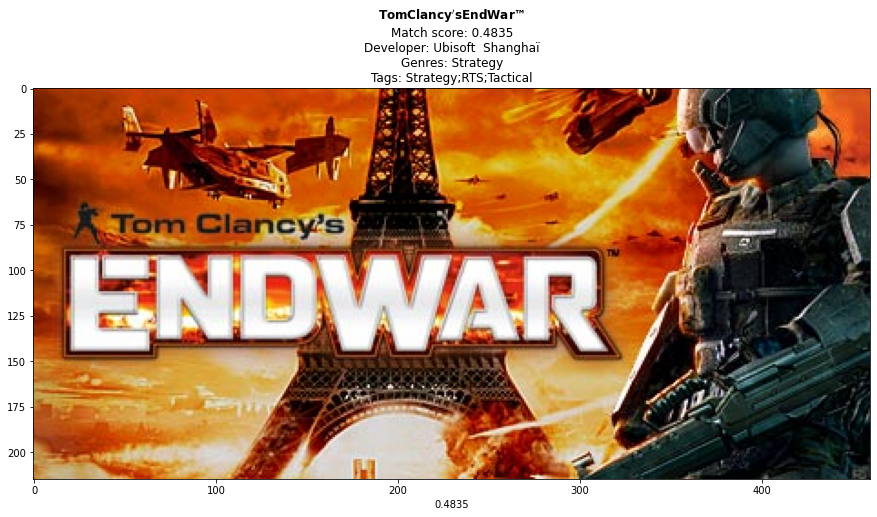

<Figure size 72x72 with 0 Axes>

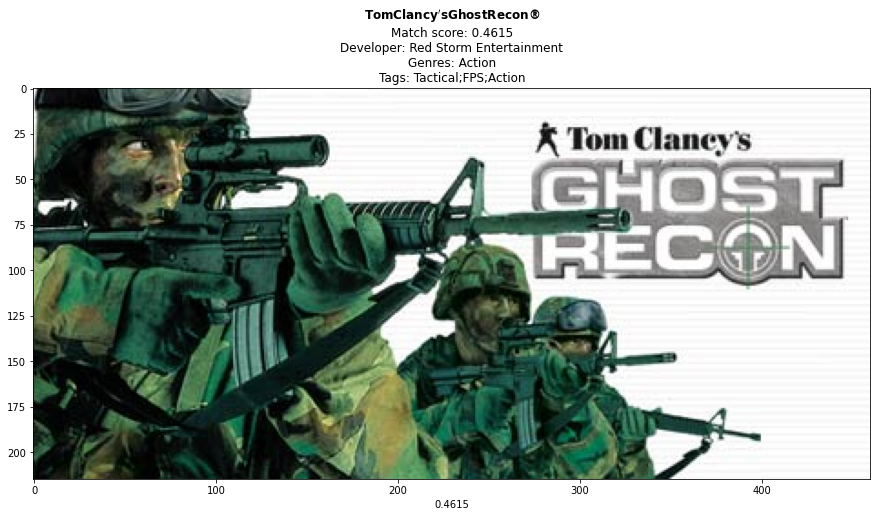

<Figure size 72x72 with 0 Axes>

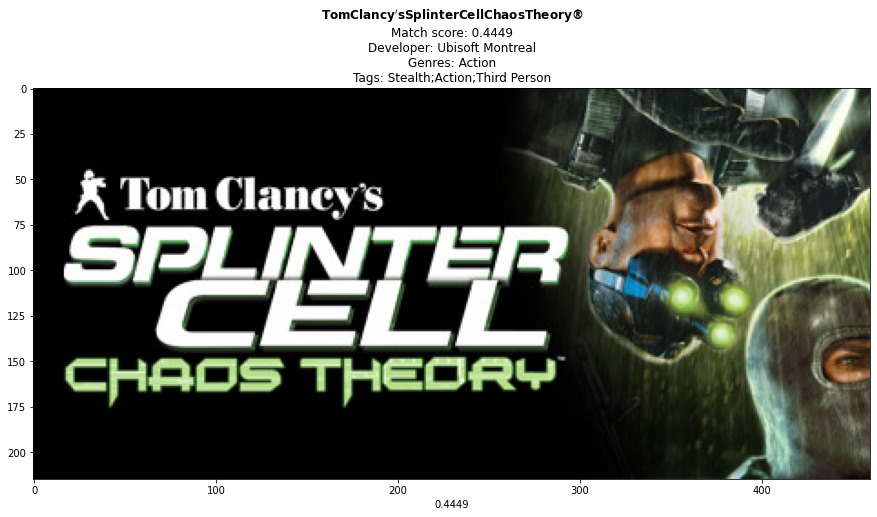

<Figure size 72x72 with 0 Axes>

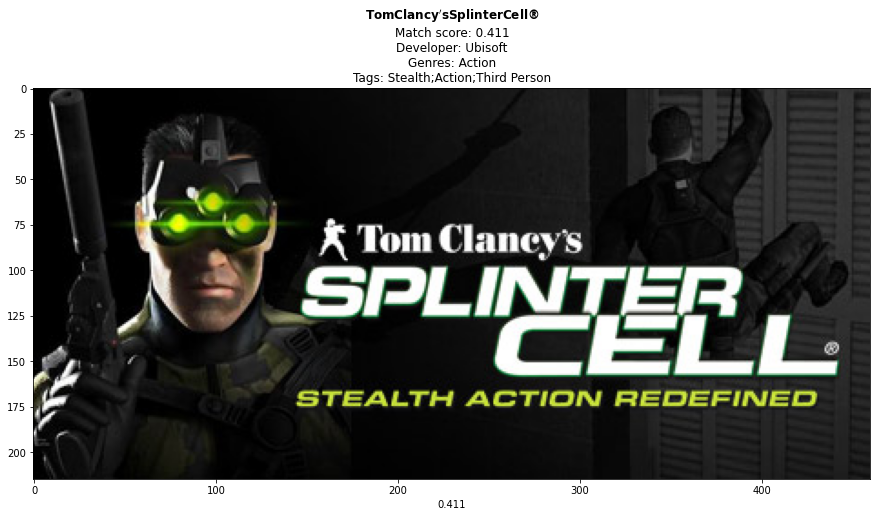

<Figure size 72x72 with 0 Axes>

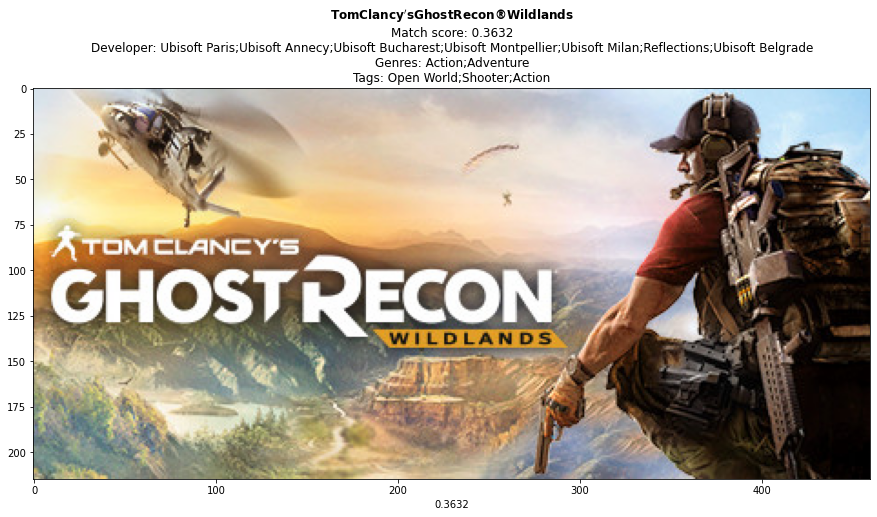

Average Match Score: 0.6066


,name,developer,genres,steamspy_tags,match_score
4079,Tom Clancy's Rainbow Six® Siege,Ubisoft Montreal,Action,FPS;Multiplayer;Tactical,1.0000
292,Tom Clancy's Rainbow Six® Vegas,Ubisoft Montreal,Action,Action;FPS;Tactical,0.8085
299,Tom Clancy's Rainbow Six® Vegas 2,Ubisoft Montreal,Action,Action;Tactical;FPS,0.8085
375,Tom Clancy's Rainbow Six® 3 Gold,Red Storm Entertainment;Ubisoft Montreal,Action,Tactical;FPS;Action,0.7543
296,Tom Clancy's Ghost Recon® Desert Siege™,Red Storm Entertainment,Action,Action;FPS;Tactical,0.5302
401,Tom Clancy's EndWar™,Ubisoft Shanghaï,Strategy,Strategy;RTS;Tactical,0.4835
308,Tom Clancy's Ghost Recon®,Red Storm Entertainment,Action,Tactical;FPS;Action,0.4615
294,Tom Clancy's Splinter Cell Chaos Theory®,Ubisoft Montreal,Action,Stealth;Action;Third Person,0.4449
293,Tom Clancy's Splinter Cell®,Ubisoft,Action,Stealth;Action;Third Person,0.4110
6477,Tom Clancy's Ghost Recon® Wildlands,Ubisoft Paris;Ubisoft Annecy;Ubisoft Bucharest...,Action;Adventure,Open World;Shooter;Action,0.3632


In [107]:
game_name = "Tom Clancy's Rainbow Six® Siege"
recommendations(name=game_name, similarity_vectorizer=cosine_TfidV)


<Figure size 72x72 with 0 Axes>

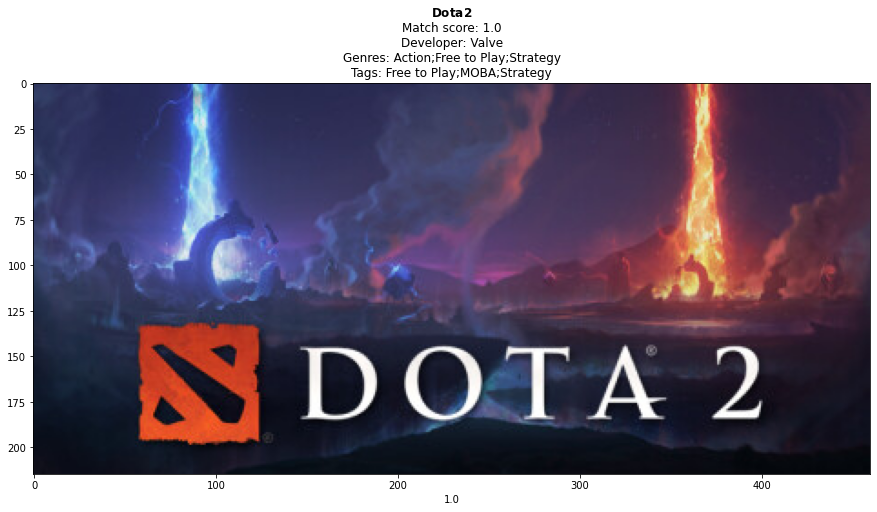

<Figure size 72x72 with 0 Axes>

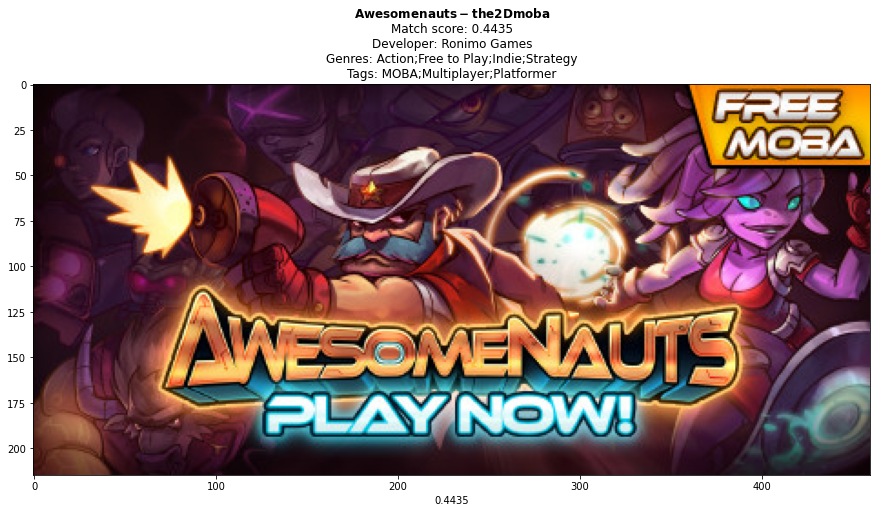

<Figure size 72x72 with 0 Axes>

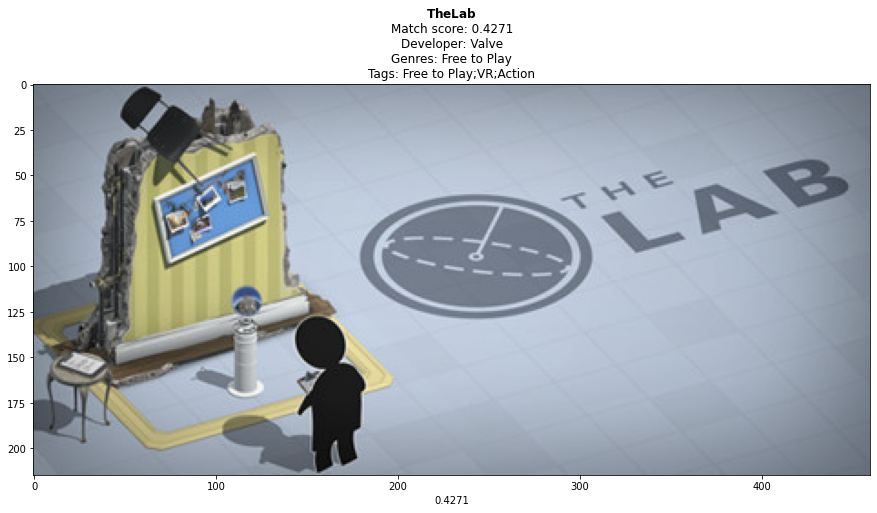

<Figure size 72x72 with 0 Axes>

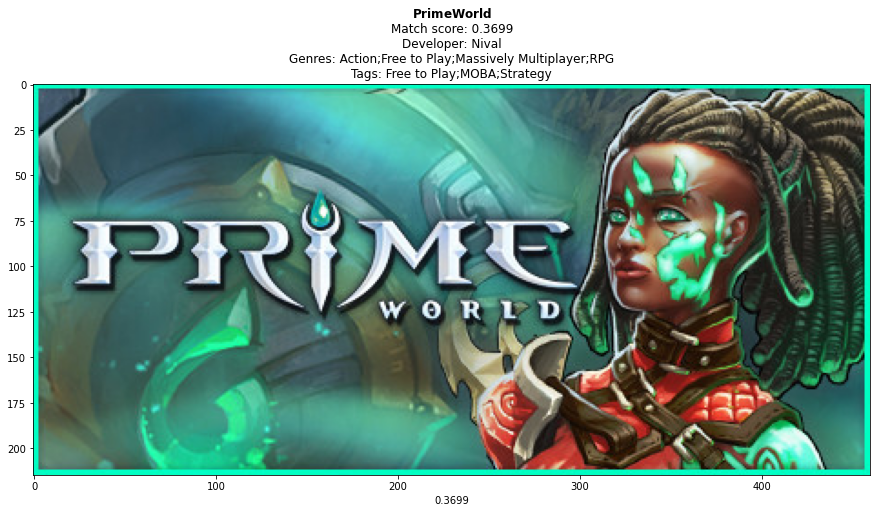

<Figure size 72x72 with 0 Axes>

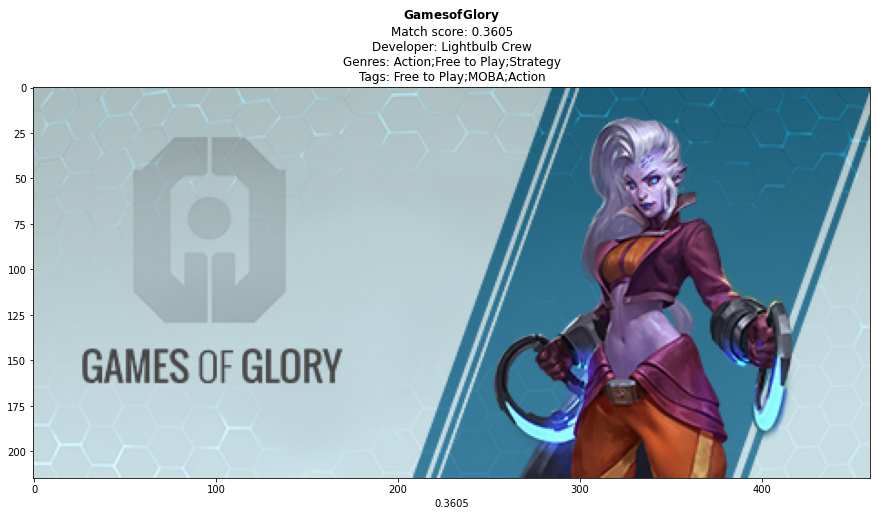

<Figure size 72x72 with 0 Axes>

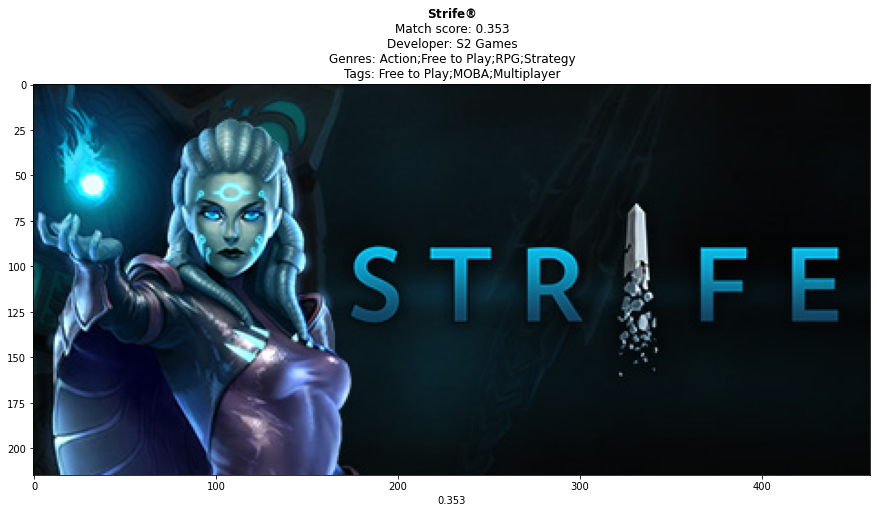

<Figure size 72x72 with 0 Axes>

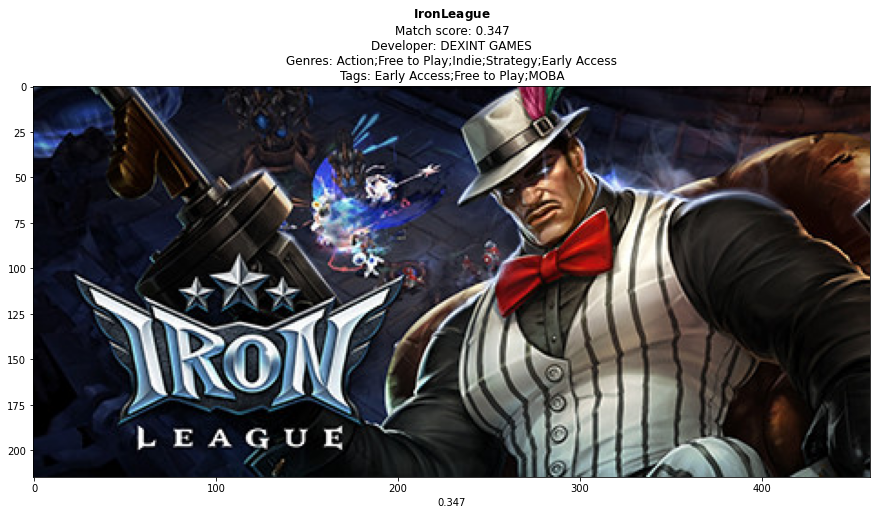

<Figure size 72x72 with 0 Axes>

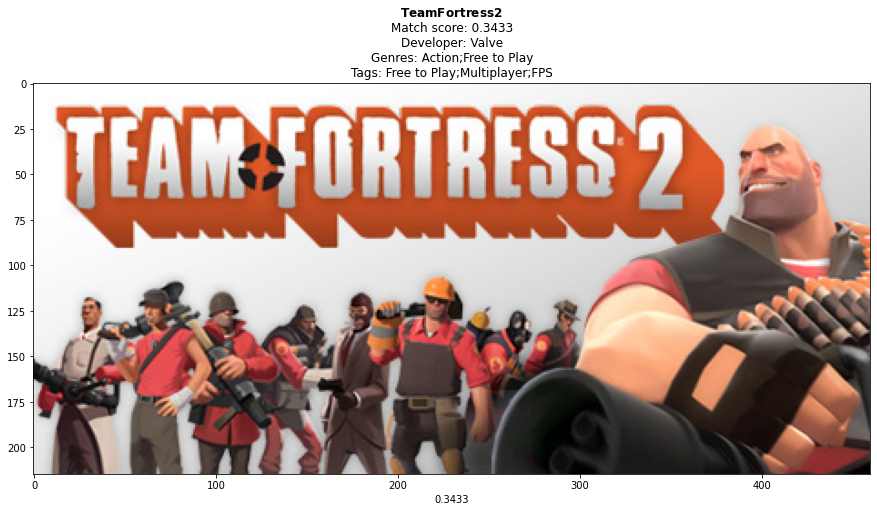

<Figure size 72x72 with 0 Axes>

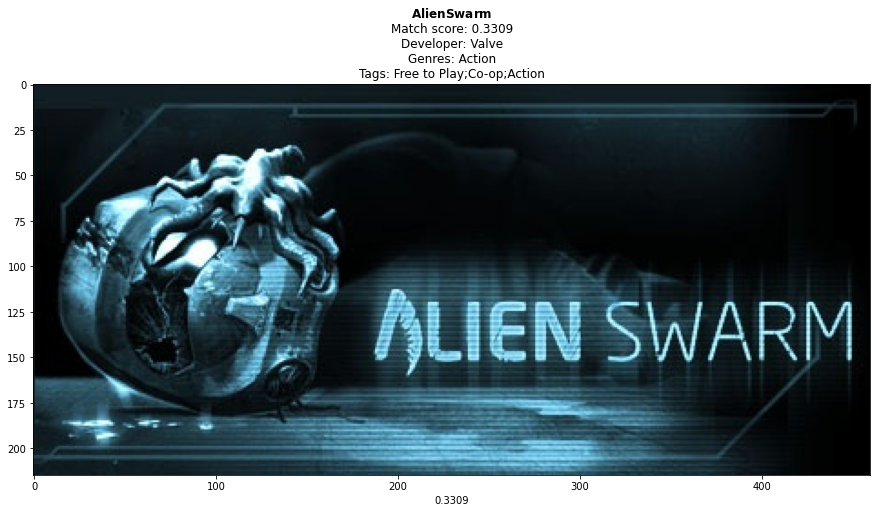

<Figure size 72x72 with 0 Axes>

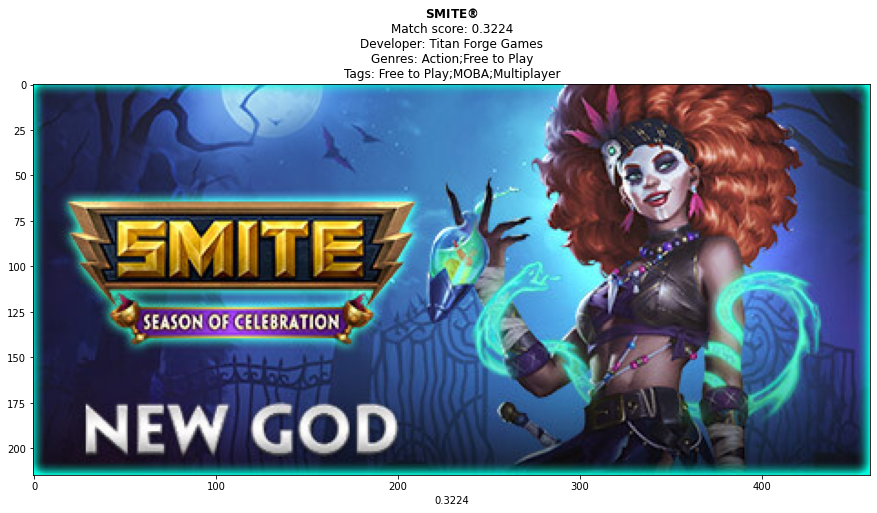

Average Match Score: 0.4298


,name,developer,genres,steamspy_tags,match_score
22,Dota 2,Valve,Action;Free to Play;Strategy,Free to Play;MOBA;Strategy,1.0000
1010,Awesomenauts - the 2D moba,Ronimo Games,Action;Free to Play;Indie;Strategy,MOBA;Multiplayer;Platformer,0.4435
6236,The Lab,Valve,Free to Play,Free to Play;VR;Action,0.4271
1422,Prime World,Nival,Action;Free to Play;Massively Multiplayer;RPG,Free to Play;MOBA;Strategy,0.3699
3606,Games of Glory,Lightbulb Crew,Action;Free to Play;Strategy,Free to Play;MOBA;Action,0.3605
3514,Strife®,S2 Games,Action;Free to Play;RPG;Strategy,Free to Play;MOBA;Multiplayer,0.3530
11565,Iron League,DEXINT GAMES,Action;Free to Play;Indie;Strategy;Early Access,Early Access;Free to Play;MOBA,0.3470
19,Team Fortress 2,Valve,Action;Free to Play,Free to Play;Multiplayer;FPS,0.3433
24,Alien Swarm,Valve,Action,Free to Play;Co-op;Action,0.3309
4743,SMITE®,Titan Forge Games,Action;Free to Play,Free to Play;MOBA;Multiplayer,0.3224


In [108]:
game_name = "Dota"
recommendations(name=game_name, similarity_vectorizer=cosine_TfidV)


<Figure size 72x72 with 0 Axes>

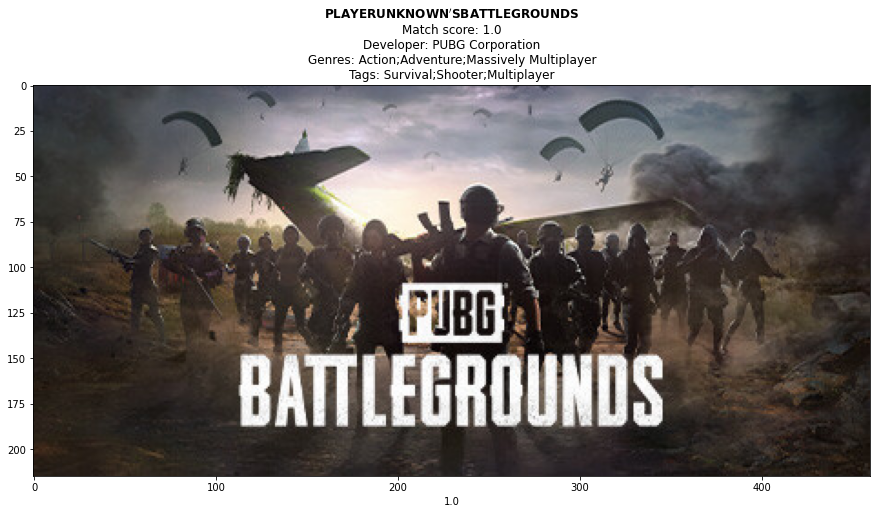

<Figure size 72x72 with 0 Axes>

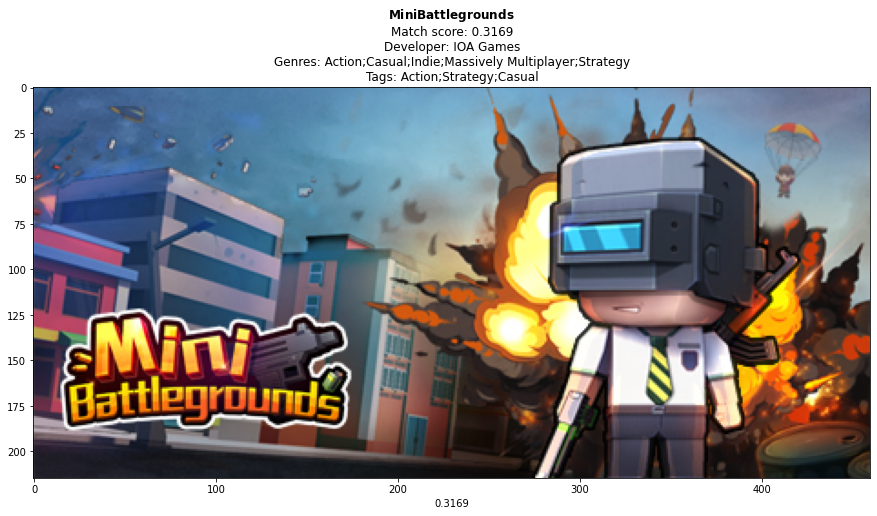

<Figure size 72x72 with 0 Axes>

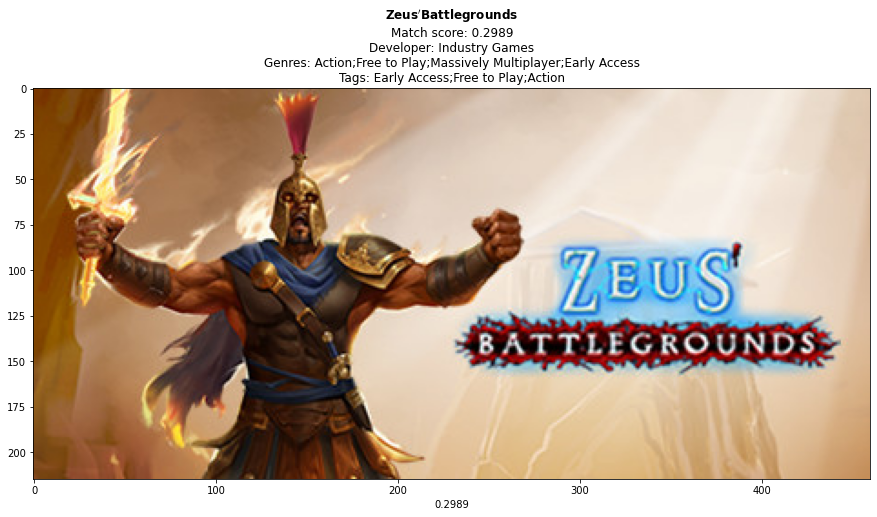

<Figure size 72x72 with 0 Axes>

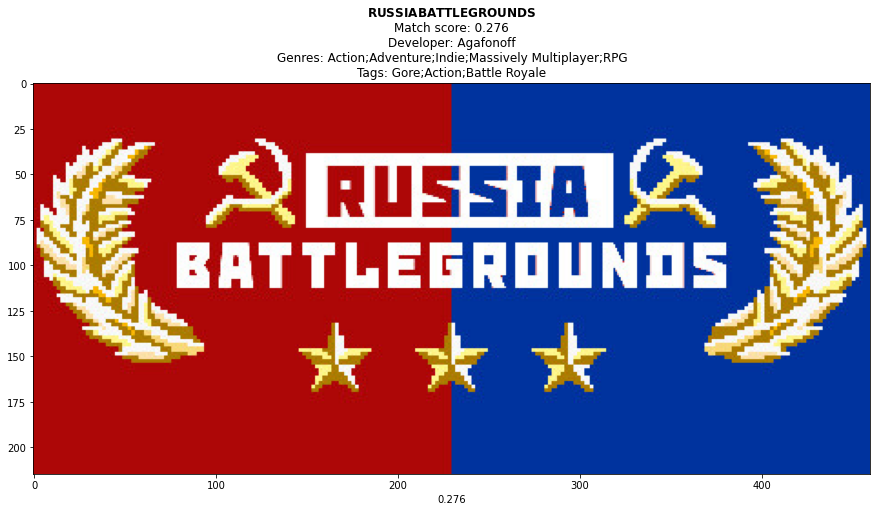

<Figure size 72x72 with 0 Axes>

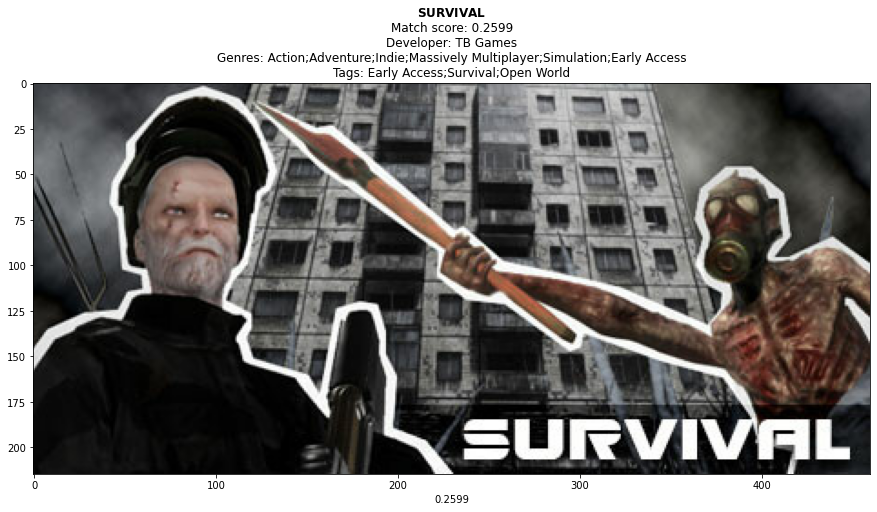

<Figure size 72x72 with 0 Axes>

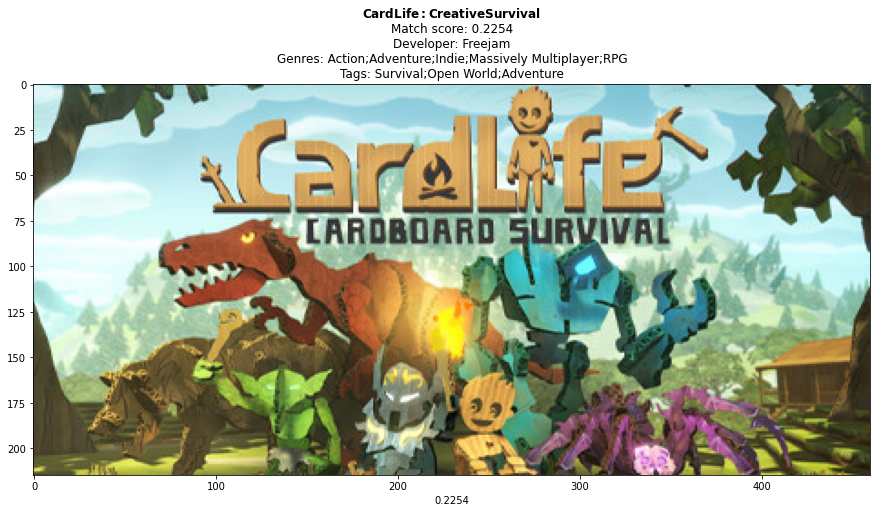

<Figure size 72x72 with 0 Axes>

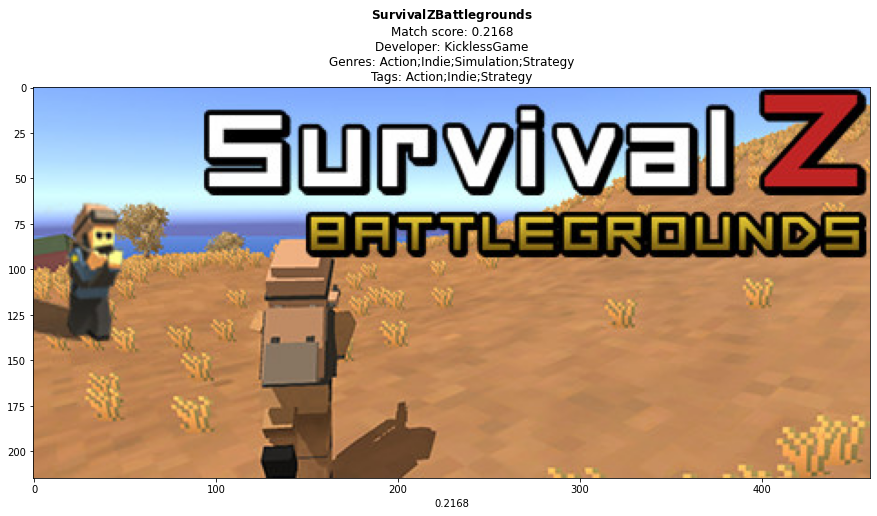

<Figure size 72x72 with 0 Axes>

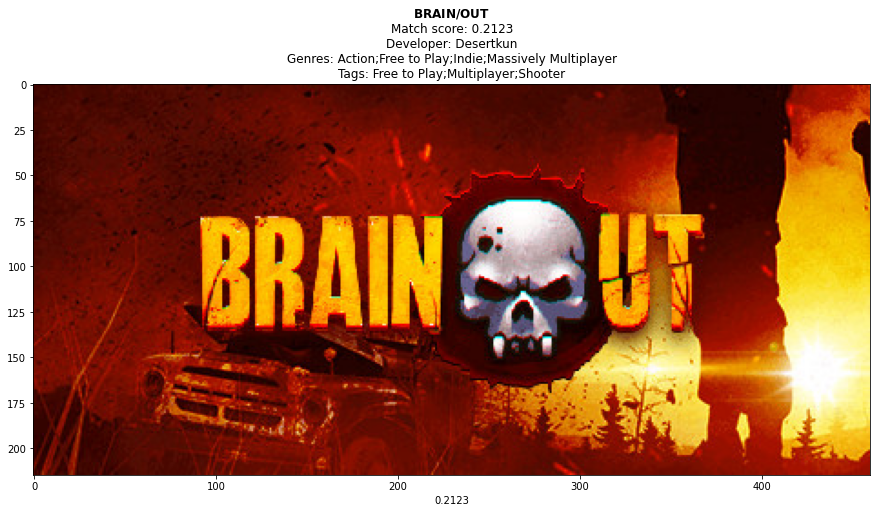

<Figure size 72x72 with 0 Axes>

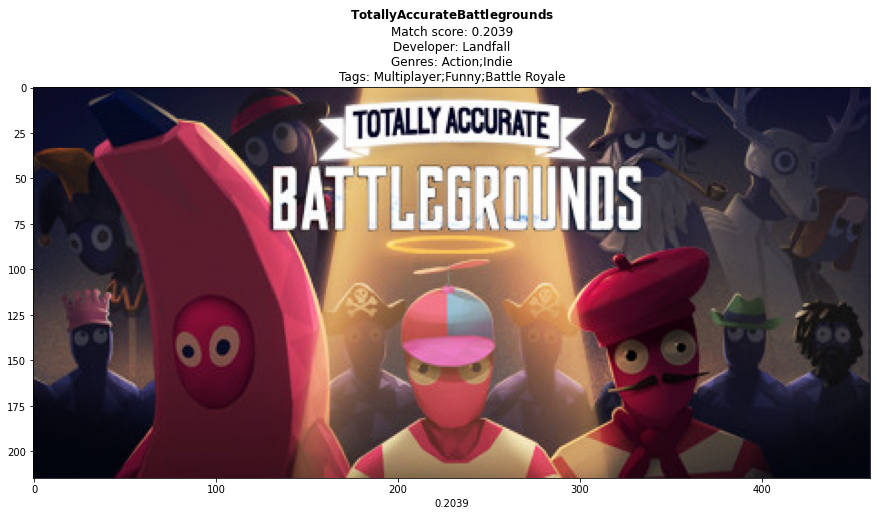

<Figure size 72x72 with 0 Axes>

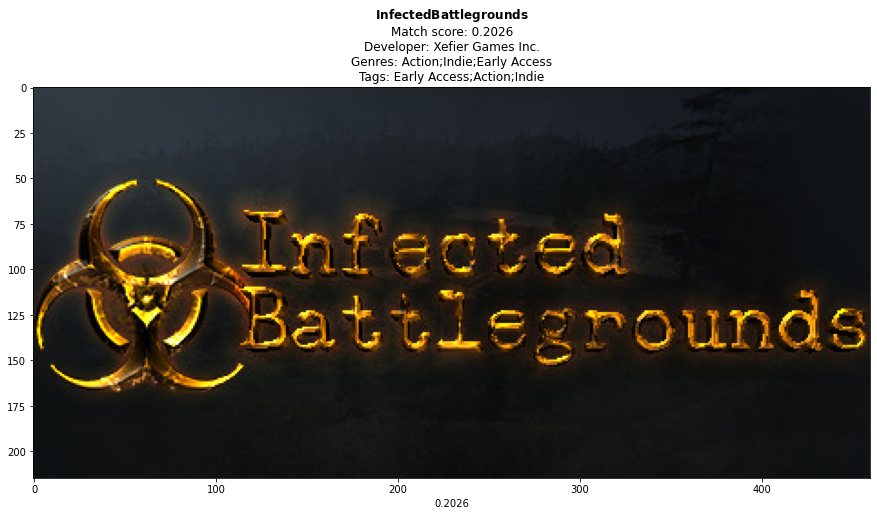

Average Match Score: 0.3213


,name,developer,genres,steamspy_tags,match_score
8752,PLAYERUNKNOWN'S BATTLEGROUNDS,PUBG Corporation,Action;Adventure;Massively Multiplayer,Survival;Shooter;Multiplayer,1.0000
10019,Mini Battlegrounds,IOA Games,Action;Casual;Indie;Massively Multiplayer;Stra...,Action;Strategy;Casual,0.3169
10386,Zeus' Battlegrounds,Industry Games,Action;Free to Play;Massively Multiplayer;Earl...,Early Access;Free to Play;Action,0.2989
11992,RUSSIA BATTLEGROUNDS,Agafonoff,Action;Adventure;Indie;Massively Multiplayer;RPG,Gore;Action;Battle Royale,0.2760
3843,SURVIVAL,TB Games,Action;Adventure;Indie;Massively Multiplayer;S...,Early Access;Survival;Open World,0.2599
13085,CardLife: Creative Survival,Freejam,Action;Adventure;Indie;Massively Multiplayer;RPG,Survival;Open World;Adventure,0.2254
12681,SurvivalZ Battlegrounds,KicklessGame,Action;Indie;Simulation;Strategy,Action;Indie;Strategy,0.2168
8756,BRAIN / OUT,Desertkun,Action;Free to Play;Indie;Massively Multiplayer,Free to Play;Multiplayer;Shooter,0.2123
12178,Totally Accurate Battlegrounds,Landfall,Action;Indie,Multiplayer;Funny;Battle Royale,0.2039
12374,Infected Battlegrounds,Xefier Games Inc.,Action;Indie;Early Access,Early Access;Action;Indie,0.2026


In [109]:
game_name = "PLAYERUNKNOWN"
recommendations(name=game_name, similarity_vectorizer=cosine_TfidV)
